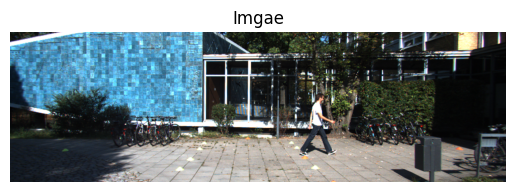

In [1]:
import cv2 as cv
import matplotlib.pyplot as plt

img = cv.imread('/kaggle/input/kitti-dataset/data_object_image_2/training/image_2/000000.png')
img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

plt.imshow(img_rgb)
plt.title('Imgae')
plt.axis('off')
plt.show()

In [1]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 27.4 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.4 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 3.4 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 5.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.3 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 86.2 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found existin

Image Resolution Summary:
             Width       Height
count  7481.000000  7481.000000
mean   1239.916321   374.477075
std       5.460402     1.545146
min    1224.000000   370.000000
25%    1242.000000   375.000000
50%    1242.000000   375.000000
75%    1242.000000   375.000000
max    1242.000000   376.000000
Unique Resolutions: [[1224, 370], [1242, 375], [1238, 374], [1241, 376]]


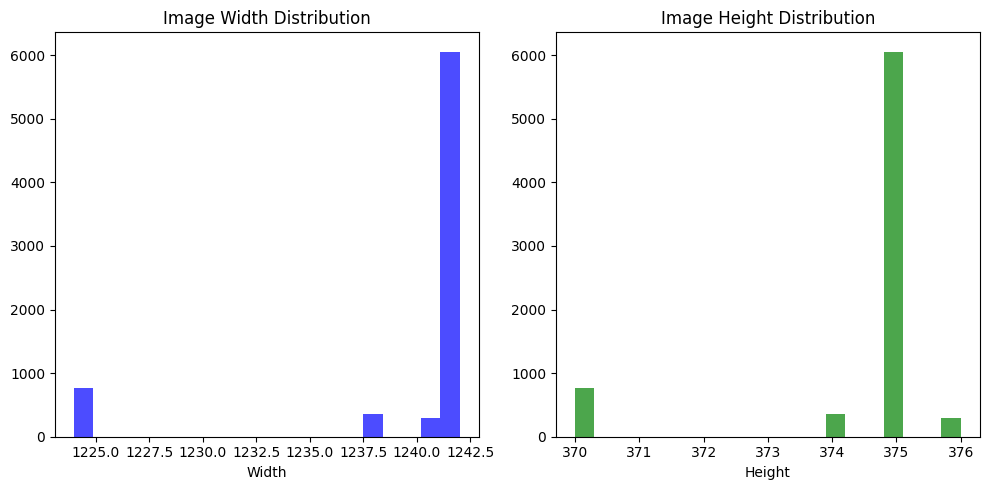


Label Issues (First 10):
000001.png: Invalid class: DontCare
000001.png: Invalid class: DontCare
000001.png: Invalid class: DontCare
000001.png: Invalid class: DontCare
000003.png: Invalid class: DontCare
000003.png: Invalid class: DontCare
000004.png: Invalid class: DontCare
000004.png: Invalid class: DontCare
000004.png: Invalid class: DontCare
000004.png: Invalid class: DontCare
Total Label Issues: 11295

Class Distribution:
Pedestrian: 4487
Truck: 1094
Car: 28742
Cyclist: 1627
Misc: 973
Van: 2914
Tram: 511
Person_sitting: 222
Total Objects: 40570


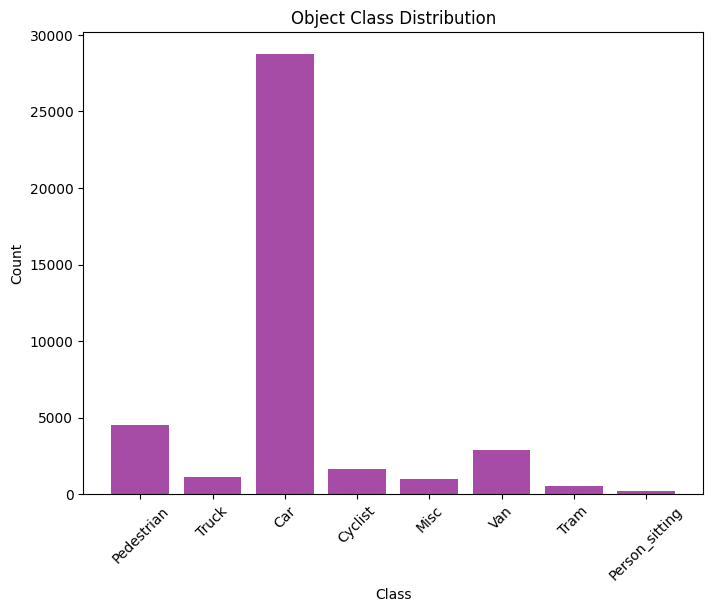


Object Size Summary (Area in pixels):
                Area
count   40570.000000
mean    11105.084639
std     18775.843646
min         1.487200
25%      1417.392000
50%      3564.392900
75%     11280.399825
max    190706.340000


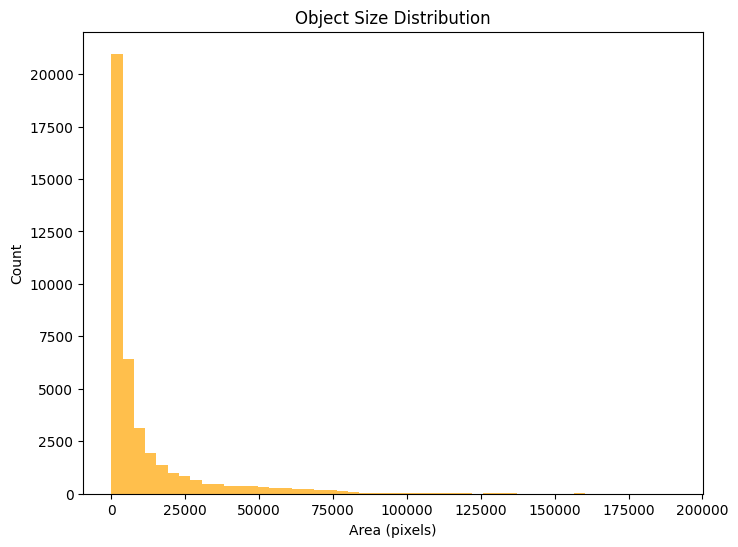

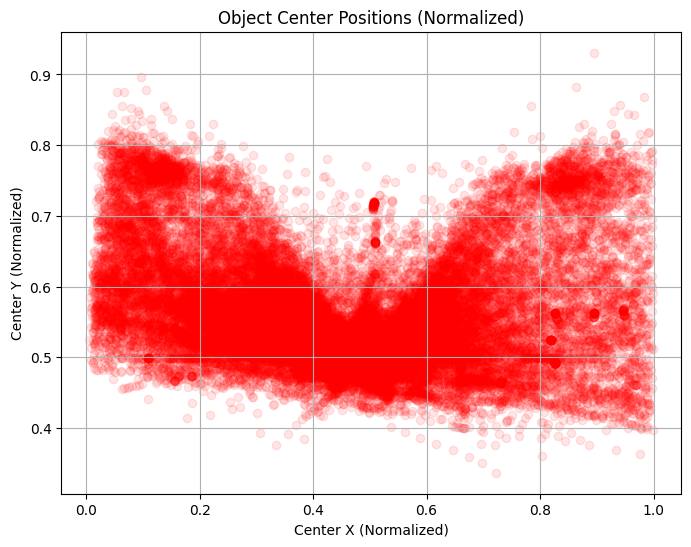

In [3]:
import cv2
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from collections import Counter

# Paths to training section of KITTI dataset
TRAIN_IMAGE_DIR = "/kaggle/input/kitti-dataset/data_object_image_2/training/image_2"
TRAIN_LABEL_DIR = "/kaggle/input/kitti-dataset/data_object_label_2/training/label_2"

# Initialize lists to store analysis results
image_resolutions = []
label_issues = []
class_counts = Counter()
object_sizes = []
object_positions = []

# Function to check image resolution
def analyze_image_resolution(image_path):
    img = cv2.imread(image_path)
    if img is None:
        return None
    height, width = img.shape[:2]
    return width, height

# Function to validate labels and extract object info
def analyze_labels(label_path, img_width, img_height):
    issues = []
    bboxes = []
    classes = []
    try:
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) < 8:
                    issues.append("Incomplete label")
                    continue
                class_name = parts[0]
                if class_name not in ['Car', 'Pedestrian', 'Cyclist', 'Van', 'Truck', 'Person_sitting', 'Tram', 'Misc']:
                    issues.append(f"Invalid class: {class_name}")
                    continue
                try:
                    x1, y1, x2, y2 = map(float, parts[4:8])
                    # Check for invalid bounding boxes
                    if x1 < 0 or y1 < 0 or x2 > img_width or y2 > img_height:
                        issues.append(f"Bounding box out of bounds: {x1, y1, x2, y2}")
                    if x1 >= x2 or y1 >= y2:
                        issues.append(f"Invalid box dimensions: {x1, y1, x2, y2}")
                    # Store valid object info
                    width = x2 - x1
                    height = y2 - y1
                    area = width * height
                    center_x = (x1 + x2) / 2
                    center_y = (y1 + y2) / 2
                    bboxes.append((x1, y1, x2, y2))
                    classes.append(class_name)
                    object_sizes.append(area)
                    object_positions.append((center_x / img_width, center_y / img_height))
                except ValueError:
                    issues.append("Invalid number format in label")
    except FileNotFoundError:
        issues.append("Label file missing")
    return issues, classes, bboxes

# Analyze training dataset
image_files = sorted(os.listdir(TRAIN_IMAGE_DIR))
for idx, file_name in enumerate(image_files):
    # Load image
    image_path = os.path.join(TRAIN_IMAGE_DIR, file_name)
    resolution = analyze_image_resolution(image_path)
    if resolution:
        image_resolutions.append(resolution)
    else:
        label_issues.append(f"Failed to load image: {file_name}")
        continue

    # Load and validate labels
    label_path = os.path.join(TRAIN_LABEL_DIR, file_name.replace('.png', '.txt'))
    img_width, img_height = resolution
    issues, classes, bboxes = analyze_labels(label_path, img_width, img_height)
    label_issues.extend([f"{file_name}: {issue}" for issue in issues])
    class_counts.update(classes)

# Convert results to DataFrame for analysis
res_df = pd.DataFrame(image_resolutions, columns=['Width', 'Height'])
size_df = pd.DataFrame(object_sizes, columns=['Area'])
pos_df = pd.DataFrame(object_positions, columns=['Center_X', 'Center_Y'])

# 1. Image Resolution Analysis
print("Image Resolution Summary:")
print(res_df.describe())
unique_resolutions = res_df.drop_duplicates().values.tolist()
print(f"Unique Resolutions: {unique_resolutions}")

# Plot resolution distribution
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.hist(res_df['Width'], bins=20, color='blue', alpha=0.7)
plt.title('Image Width Distribution')
plt.xlabel('Width')
plt.subplot(1, 2, 2)
plt.hist(res_df['Height'], bins=20, color='green', alpha=0.7)
plt.title('Image Height Distribution')
plt.xlabel('Height')
plt.tight_layout()
plt.show()

# 2. Label Accuracy
print("\nLabel Issues (First 10):")
for issue in label_issues[:10]:
    print(issue)
print(f"Total Label Issues: {len(label_issues)}")

# 3. Object Representation (Class Imbalance)
print("\nClass Distribution:")
for cls, count in class_counts.items():
    print(f"{cls}: {count}")
total_objects = sum(class_counts.values())
print(f"Total Objects: {total_objects}")

# Plot class distribution
plt.figure(figsize=(8, 6))
plt.bar(class_counts.keys(), class_counts.values(), color='purple', alpha=0.7)
plt.title('Object Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

# 4. Object Size and Position Analysis
print("\nObject Size Summary (Area in pixels):")
print(size_df.describe())

# Plot object size distribution
plt.figure(figsize=(8, 6))
plt.hist(size_df['Area'], bins=50, color='orange', alpha=0.7)
plt.title('Object Size Distribution')
plt.xlabel('Area (pixels)')
plt.ylabel('Count')
plt.show()

# Plot object position distribution
plt.figure(figsize=(8, 6))
plt.scatter(pos_df['Center_X'], pos_df['Center_Y'], alpha=0.1, color='red')
plt.title('Object Center Positions (Normalized)')
plt.xlabel('Center X (Normalized)')
plt.ylabel('Center Y (Normalized)')
plt.grid(True)
plt.show()

In [6]:
import os
import cv2
import numpy as np
from ultralytics import YOLO
from pathlib import Path
from sklearn.metrics import precision_recall_fscore_support
from tqdm import tqdm
import random
import shutil

# Define paths
KITTI_DATASET_PATH = "/kaggle/input/kitti-dataset"
KITTI_IMAGES_PATH = os.path.join(KITTI_DATASET_PATH, 'data_object_image_2', 'training', 'image_2')
KITTI_LABELS_PATH = os.path.join(KITTI_DATASET_PATH, 'data_object_label_2', 'training', 'label_2')
OUTPUT_DATA_PATH = "/kaggle/working/kitti_yolo_split"
OUTPUT_INFERENCE_DIR = "/kaggle/working/runs_n/yolov11n_kitti_inference"
MODEL_PATH = "yolo11n.pt"  # Pre-trained COCO model

# Create output directories
for split in ['train', 'val', 'test']:
    os.makedirs(os.path.join(OUTPUT_DATA_PATH, 'images', split), exist_ok=True)
    os.makedirs(os.path.join(OUTPUT_DATA_PATH, 'labels', split), exist_ok=True)
os.makedirs(os.path.join(OUTPUT_INFERENCE_DIR, 'images'), exist_ok=True)
os.makedirs(os.path.join(OUTPUT_INFERENCE_DIR, 'predictions'), exist_ok=True)

def split_dataset(image_files, train_ratio=0.7, val_ratio=0.1, test_ratio=0.2):
    """Split dataset into train, val, and test sets."""
    random.seed(42)  # For reproducibility
    random.shuffle(image_files)
    total = len(image_files)
    train_end = int(train_ratio * total)
    val_end = train_end + int(val_ratio * total)
    
    train_files = image_files[:train_end]
    val_files = image_files[train_end:val_end]
    test_files = image_files[val_end:]
    
    return train_files, val_files, test_files

def copy_files(files, split, src_img_path, src_label_path, dst_img_path, dst_label_path):
    """Copy images and labels to destination split folder."""
    for file in files:
        shutil.copy(os.path.join(src_img_path, file), os.path.join(dst_img_path, split, file))
        label_file = file.replace('.png', '.txt')
        if os.path.exists(os.path.join(src_label_path, label_file)):
            shutil.copy(os.path.join(src_label_path, label_file), os.path.join(dst_label_path, split, label_file))

def create_data_yaml(output_path):
    """Create data.yaml for the split dataset."""
    data_yaml_content = f"""
train: {os.path.join(OUTPUT_DATA_PATH, 'images', 'train')}
val: {os.path.join(OUTPUT_DATA_PATH, 'images', 'val')}
test: {os.path.join(OUTPUT_DATA_PATH, 'images', 'test')}
nc: 8
names: ['Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram', 'Misc']
"""
    with open(os.path.join(output_path, 'data.yaml'), 'w') as f:
        f.write(data_yaml_content)

def load_kitti_labels(label_path):
    """Load KITTI labels and convert to YOLO format."""
    labels = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) < 8:
                    continue
                class_name = parts[0].lower()
                class_id = (
                    0 if class_name == 'car' else
                    1 if class_name == 'van' else
                    2 if class_name == 'truck' else
                    3 if class_name == 'pedestrian' else
                    4 if class_name == 'person_sitting' else
                    5 if class_name == 'cyclist' else
                    6 if class_name == 'tram' else
                    7 if class_name == 'misc' else
                    -1  # Ignore 'dontcare' or other classes
                )
                if class_id == -1:
                    continue
                x_min, y_min, x_max, y_max = map(float, parts[4:8])
                width = x_max - x_min
                height = y_max - y_min
                x_center = x_min + width / 2
                y_center = y_min + height / 2
                x_center /= 1242
                y_center /= 375
                width /= 1242
                height /= 375
                labels.append([class_id, x_center, y_center, width, height])
    return np.array(labels)

def calculate_iou(box1, box2):
    """Calculate IoU between two bounding boxes."""
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    x1_min, y1_min = x1 - w1 / 2, y1 - h1 / 2
    x1_max, y1_max = x1 + w1 / 2, y1 + h1 / 2
    x2_min, y2_min = x2 - w2 / 2, y2 - h2 / 2
    x2_max, y2_max = x2 + w2 / 2, y2 + h2 / 2

    inter_x_min = max(x1_min, x2_min)
    inter_y_min = max(y1_min, y2_min)
    inter_x_max = min(x1_max, x2_max)
    inter_y_max = min(y1_max, y2_max)

    inter_area = max(0, inter_x_max - inter_x_min) * max(0, inter_y_max - inter_y_min)
    union_area = (w1 * h1) + (w2 * h2) - inter_area
    return inter_area / union_area if union_area > 0 else 0

def evaluate_predictions(predictions, ground_truths, iou_threshold=0.5):
    """Evaluate predictions per class."""
    class_metrics = {
        0: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        1: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        2: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        3: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        4: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        5: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        6: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        7: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0}
    }

    for pred, gt in zip(predictions, ground_truths):
        pred_boxes = pred['boxes'] if pred else []
        gt_boxes = gt

        for class_id in class_metrics:
            pred_cls = [p for p in pred_boxes if p[0] == class_id]
            gt_cls = [g for g in gt_boxes if g[0] == class_id]
            class_metrics[class_id]['pred_count'] += len(pred_cls)
            class_metrics[class_id]['gt_count'] += len(gt_cls)
            matched = set()

            for i, pb in enumerate(pred_cls):
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_cls):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_threshold and max_idx not in matched:
                    class_metrics[class_id]['tp'] += 1
                    matched.add(max_idx)
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(class_id)
                else:
                    class_metrics[class_id]['fp'] += 1
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(-1)

            class_metrics[class_id]['fn'] += len(gt_cls) - len(matched)
            for j, gb in enumerate(gt_cls):
                if j not in matched:
                    class_metrics[class_id]['gts'].append(class_id)
                    class_metrics[class_id]['preds'].append(-1)

    metrics = {}
    for class_id, data in class_metrics.items():
        precision, recall, f1, _ = precision_recall_fscore_support(
            data['gts'], data['preds'], average='macro', zero_division=0
        )
        metrics[class_id] = {
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'mAP': calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold),
            'pred_count': data['pred_count'],
            'gt_count': data['gt_count']
        }

    all_precisions = [m['precision'] for m in metrics.values()]
    all_recalls = [m['recall'] for m in metrics.values()]
    all_f1s = [m['f1'] for m in metrics.values()]
    all_maps = [m['mAP'] for m in metrics.values()]
    overall = {
        'precision': np.mean(all_precisions),
        'recall': np.mean(all_recalls),
        'f1': np.mean(all_f1s),
        'mAP': np.mean(all_maps)
    }

    return metrics, overall

def calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold=0.5):
    """Calculate mAP for a specific class."""
    precisions, recalls = [], []
    for iou_th in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = 0, 0, 0
        for pred, gt in zip(predictions, ground_truths):
            pred_boxes = [p for p in (pred['boxes'] if pred else []) if p[0] == class_id]
            gt_boxes = [g for g in gt if g[0] == class_id]
            matched = set()
            for pb in pred_boxes:
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_boxes):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_th and max_idx not in matched:
                    tp += 1
                    matched.add(max_idx)
                else:
                    fp += 1
            fn += len(gt_boxes) - len(matched)
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)
    
    if precisions and recalls:
        precisions = np.array(precisions)
        recalls = np.array(recalls)
        sorted_idx = np.argsort(recalls)
        precisions = precisions[sorted_idx]
        recalls = recalls[sorted_idx]
        for i in range(len(precisions) - 2, -1, -1):
            precisions[i] = max(precisions[i], precisions[i + 1])
        ap = np.trapz(precisions, recalls) if recalls.size > 1 else 0
        ap = max(0, ap)
    else:
        ap = 0
    return ap

def main():
    # Load image files
    image_files = sorted([f for f in os.listdir(KITTI_IMAGES_PATH) if f.endswith('.png')])
    print(f"Found {len(image_files)} images.")

    # Split dataset
    train_files, val_files, test_files = split_dataset(image_files)
    print(f"Train: {len(train_files)} images, Val: {len(val_files)} images, Test: {len(test_files)} images")

    # Copy files to split folders
    copy_files(train_files, 'train', KITTI_IMAGES_PATH, KITTI_LABELS_PATH, 
               os.path.join(OUTPUT_DATA_PATH, 'images'), os.path.join(OUTPUT_DATA_PATH, 'labels'))
    copy_files(val_files, 'val', KITTI_IMAGES_PATH, KITTI_LABELS_PATH, 
               os.path.join(OUTPUT_DATA_PATH, 'images'), os.path.join(OUTPUT_DATA_PATH, 'labels'))
    copy_files(test_files, 'test', KITTI_IMAGES_PATH, KITTI_LABELS_PATH, 
               os.path.join(OUTPUT_DATA_PATH, 'images'), os.path.join(OUTPUT_DATA_PATH, 'labels'))

    # Create data.yaml
    create_data_yaml(OUTPUT_DATA_PATH)
    print(f"Created data.yaml at {os.path.join(OUTPUT_DATA_PATH, 'data.yaml')}")

    # Load YOLOv11 model
    model = YOLO(MODEL_PATH)
    print(f"Loaded YOLOv11 model: {MODEL_PATH}")

    # Run inference on test split
    predictions = []
    ground_truths = []
    test_images_path = os.path.join(OUTPUT_DATA_PATH, 'images', 'test')
    test_labels_path = os.path.join(OUTPUT_DATA_PATH, 'labels', 'test')

    for img_file in tqdm(test_files, desc="Running inference on test split"):
        img_path = os.path.join(test_images_path, img_file)
        label_path = os.path.join(test_labels_path, img_file.replace('.png', '.txt'))
        pred_file = os.path.join(OUTPUT_INFERENCE_DIR, 'predictions', img_file.replace('.png', '.txt'))

        # Load image
        img = cv2.imread(img_path)
        if img is None:
            print(f"Failed to load image: {img_path}")
            continue

        # Run inference
        results = model.predict(img_path, conf=0.25, iou=0.7, verbose=False)

        # Process predictions
        pred_boxes = []
        for result in results:
            boxes = result.boxes
            for box, cls, conf in zip(boxes.xywhn, boxes.cls, boxes.conf):
                coco_cls = int(cls)
                if coco_cls == 2:  # COCO car -> KITTI Car
                    class_id = 0
                elif coco_cls == 7:  # COCO truck -> KITTI Van or Truck
                    class_id = 1 if random.random() < 0.5 else 2  # Approximate split
                elif coco_cls == 0:  # COCO person -> KITTI Pedestrian or Person_sitting
                    class_id = 3 if random.random() < 0.8 else 4  # Approximate split
                elif coco_cls == 1:  # COCO bicycle -> KITTI Cyclist
                    class_id = 5
                elif coco_cls == 5:  # COCO train -> KITTI Tram
                    class_id = 6
                elif coco_cls in [3, 8, 16, 17, 18]:  # COCO motorcycle, boat, bird, cat, dog -> KITTI Misc
                    class_id = 7
                else:
                    continue
                pred_boxes.append([class_id, float(box[0]), float(box[1]), float(box[2]), float(box[3])])
        predictions.append({'boxes': pred_boxes})

        # Save predictions
        with open(pred_file, 'w') as f:
            for box in pred_boxes:
                f.write(f"{box[0]} {box[1]:.6f} {box[2]:.6f} {box[3]:.6f} {box[4]:.6f}\n")

        # Load ground truth
        gt_boxes = load_kitti_labels(label_path)
        ground_truths.append(gt_boxes)

        # Save visualization
        result_img = results[0].plot()
        cv2.imwrite(os.path.join(OUTPUT_INFERENCE_DIR, 'images', img_file), result_img)

    # Evaluate performance
    class_metrics, overall_metrics = evaluate_predictions(predictions, ground_truths, iou_threshold=0.5)
    class_names = {0: 'Car', 1: 'Van', 2: 'Truck', 3: 'Pedestrian', 4: 'Person_sitting', 5: 'Cyclist', 6: 'Tram', 7: 'Misc'}

    print("\nPerformance Metrics on KITTI Test Split (COCO Model):")
    for class_id, metrics in class_metrics.items():
        print(f"Class: {class_names[class_id]}")
        print(f"  Precision: {metrics['precision']:.4f}")
        print(f"  Recall: {metrics['recall']:.4f}")
        print(f"  F1 Score: {metrics['f1']:.4f}")
        print(f"  mAP@0.5: {metrics['mAP']:.4f}")
        print(f"  Predicted Instances: {metrics['pred_count']}")
        print(f"  Ground Truth Instances: {metrics['gt_count']}")
    print("Overall (Macro-Average):")
    print(f"  Precision: {overall_metrics['precision']:.4f}")
    print(f"  Recall: {overall_metrics['recall']:.4f}")
    print(f"  F1 Score: {overall_metrics['f1']:.4f}")
    print(f"  mAP@0.5: {overall_metrics['mAP']:.4f}")

    print(f"\nPredictions saved to {os.path.join(OUTPUT_INFERENCE_DIR, 'predictions')}")
    print(f"Visualizations saved to {os.path.join(OUTPUT_INFERENCE_DIR, 'images')}")

if __name__ == "__main__":
    main()

Found 7481 images.
Train: 5236 images, Val: 748 images, Test: 1497 images
Created data.yaml at /kaggle/working/kitti_yolo_split/data.yaml
Loaded YOLOv11 model: yolo11n.pt


Running inference on test split: 100%|██████████| 1497/1497 [01:31<00:00, 16.32it/s]



Performance Metrics on KITTI Test Split (COCO Model):
Class: Car
  Precision: 0.3154
  Recall: 0.3654
  F1 Score: 0.3386
  mAP@0.5: 0.4528
  Predicted Instances: 6580
  Ground Truth Instances: 5680
Class: Van
  Precision: 0.2054
  Recall: 0.0471
  F1 Score: 0.0766
  mAP@0.5: 0.0379
  Predicted Instances: 129
  Ground Truth Instances: 563
Class: Truck
  Precision: 0.0766
  Recall: 0.0530
  F1 Score: 0.0627
  mAP@0.5: 0.0163
  Predicted Instances: 137
  Ground Truth Instances: 198
Class: Pedestrian
  Precision: 0.2409
  Recall: 0.2148
  F1 Score: 0.2271
  mAP@0.5: 0.2070
  Predicted Instances: 799
  Ground Truth Instances: 896
Class: Person_sitting
  Precision: 0.0090
  Recall: 0.0500
  F1 Score: 0.0153
  mAP@0.5: 0.0018
  Predicted Instances: 166
  Ground Truth Instances: 30
Class: Cyclist
  Precision: 0.0291
  Recall: 0.0180
  F1 Score: 0.0222
  mAP@0.5: 0.0021
  Predicted Instances: 189
  Ground Truth Instances: 306
Class: Tram
  Precision: 0.0312
  Recall: 0.0303
  F1 Score: 0.0308


In [3]:
import os
import cv2
import numpy as np
from ultralytics import YOLO
from pathlib import Path
from sklearn.metrics import precision_recall_fscore_support
from tqdm import tqdm
import random

# Define paths
SPLIT_DATA_PATH = "/kaggle/working/kitti_yolo_split"
TEST_IMAGES_PATH = os.path.join(SPLIT_DATA_PATH, 'images', 'test')
TEST_LABELS_PATH = os.path.join(SPLIT_DATA_PATH, 'labels', 'test')
OUTPUT_INFERENCE_DIR = "/kaggle/working/runs_m/yolov11m_kitti_inference"
MODEL_PATH = "yolo11m.pt"  # Pre-trained COCO medium model

# Create output directories
os.makedirs(os.path.join(OUTPUT_INFERENCE_DIR, 'images'), exist_ok=True)
os.makedirs(os.path.join(OUTPUT_INFERENCE_DIR, 'predictions'), exist_ok=True)

def load_kitti_labels(label_path):
    """Load KITTI-format labels and convert to YOLO format."""
    labels = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) < 8:
                    continue
                class_name = parts[0].lower()
                class_id = (
                    0 if class_name == 'car' else
                    1 if class_name == 'van' else
                    2 if class_name == 'truck' else
                    3 if class_name == 'pedestrian' else
                    4 if class_name == 'person_sitting' else
                    5 if class_name == 'cyclist' else
                    6 if class_name == 'tram' else
                    7 if class_name == 'misc' else
                    -1  # Ignore 'dontcare' or other classes
                )
                if class_id == -1:
                    continue
                x_min, y_min, x_max, y_max = map(float, parts[4:8])
                width = x_max - x_min
                height = y_max - y_min
                x_center = x_min + width / 2
                y_center = y_min + height / 2
                # Normalize coordinates (KITTI images are ~1242x375)
                x_center /= 1242
                y_center /= 375
                width /= 1242
                height /= 375
                labels.append([class_id, x_center, y_center, width, height])
    return np.array(labels)

def calculate_iou(box1, box2):
    """Calculate IoU between two bounding boxes."""
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    x1_min, y1_min = x1 - w1 / 2, y1 - h1 / 2
    x1_max, y1_max = x1 + w1 / 2, y1 + h1 / 2
    x2_min, y2_min = x2 - w2 / 2, y2 - h2 / 2
    x2_max, y2_max = x2 + w2 / 2, y2 + h2 / 2

    inter_x_min = max(x1_min, x2_min)
    inter_y_min = max(y1_min, y2_min)
    inter_x_max = min(x1_max, x2_max)
    inter_y_max = min(y1_max, y2_max)

    inter_area = max(0, inter_x_max - inter_x_min) * max(0, inter_y_max - inter_y_min)
    union_area = (w1 * h1) + (w2 * h2) - inter_area
    return inter_area / union_area if union_area > 0 else 0

def evaluate_predictions(predictions, ground_truths, iou_threshold=0.5):
    """Evaluate predictions per class."""
    class_metrics = {
        0: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        1: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        2: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        3: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        4: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        5: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        6: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        7: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0}
    }

    for pred, gt in zip(predictions, ground_truths):
        pred_boxes = pred['boxes'] if pred else []
        gt_boxes = gt

        for class_id in class_metrics:
            pred_cls = [p for p in pred_boxes if p[0] == class_id]
            gt_cls = [g for g in gt_boxes if g[0] == class_id]
            class_metrics[class_id]['pred_count'] += len(pred_cls)
            class_metrics[class_id]['gt_count'] += len(gt_cls)
            matched = set()

            for i, pb in enumerate(pred_cls):
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_cls):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_threshold and max_idx not in matched:
                    class_metrics[class_id]['tp'] += 1
                    matched.add(max_idx)
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(class_id)
                else:
                    class_metrics[class_id]['fp'] += 1
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(-1)

            class_metrics[class_id]['fn'] += len(gt_cls) - len(matched)
            for j, gb in enumerate(gt_cls):
                if j not in matched:
                    class_metrics[class_id]['gts'].append(class_id)
                    class_metrics[class_id]['preds'].append(-1)

    metrics = {}
    for class_id, data in class_metrics.items():
        precision, recall, f1, _ = precision_recall_fscore_support(
            data['gts'], data['preds'], average='macro', zero_division=0
        )
        metrics[class_id] = {
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'mAP': calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold),
            'pred_count': data['pred_count'],
            'gt_count': data['gt_count']
        }

    all_precisions = [m['precision'] for m in metrics.values()]
    all_recalls = [m['recall'] for m in metrics.values()]
    all_f1s = [m['f1'] for m in metrics.values()]
    all_maps = [m['mAP'] for m in metrics.values()]
    overall = {
        'precision': np.mean(all_precisions),
        'recall': np.mean(all_recalls),
        'f1': np.mean(all_f1s),
        'mAP': np.mean(all_maps)
    }

    return metrics, overall

def calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold=0.5):
    """Calculate mAP for a specific class."""
    precisions, recalls = [], []
    for iou_th in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = 0, 0, 0
        for pred, gt in zip(predictions, ground_truths):
            pred_boxes = [p for p in (pred['boxes'] if pred else []) if p[0] == class_id]
            gt_boxes = [g for g in gt if g[0] == class_id]
            matched = set()
            for pb in pred_boxes:
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_boxes):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_th and max_idx not in matched:
                    tp += 1
                    matched.add(max_idx)
                else:
                    fp += 1
            fn += len(gt_boxes) - len(matched)
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)
    
    if precisions and recalls:
        precisions = np.array(precisions)
        recalls = np.array(recalls)
        sorted_idx = np.argsort(recalls)
        precisions = precisions[sorted_idx]
        recalls = recalls[sorted_idx]
        for i in range(len(precisions) - 2, -1, -1):
            precisions[i] = max(precisions[i], precisions[i + 1])
        ap = np.trapz(precisions, recalls) if recalls.size > 1 else 0
        ap = max(0, ap)
    else:
        ap = 0
    return ap

def main():
    # Load test split files
    test_files = sorted([f for f in os.listdir(TEST_IMAGES_PATH) if f.endswith('.png')])
    print(f"Found {len(test_files)} test images in {TEST_IMAGES_PATH}")

    # Load YOLOv11 medium model
    model = YOLO(MODEL_PATH)
    print(f"Loaded YOLOv11 model: {MODEL_PATH}")

    # Run inference on test split
    predictions = []
    ground_truths = []
    for img_file in tqdm(test_files, desc="Running inference on test split"):
        img_path = os.path.join(TEST_IMAGES_PATH, img_file)
        label_path = os.path.join(TEST_LABELS_PATH, img_file.replace('.png', '.txt'))
        pred_file = os.path.join(OUTPUT_INFERENCE_DIR, 'predictions', img_file.replace('.png', '.txt'))

        # Load image
        img = cv2.imread(img_path)
        if img is None:
            print(f"Failed to load image: {img_path}")
            continue

        # Run inference
        results = model.predict(img_path, conf=0.25, iou=0.7, verbose=False)

        # Process predictions
        pred_boxes = []
        for result in results:
            boxes = result.boxes
            for box, cls, conf in zip(boxes.xywhn, boxes.cls, boxes.conf):
                coco_cls = int(cls)
                if coco_cls == 2:  # COCO car -> KITTI Car
                    class_id = 0
                elif coco_cls == 7:  # COCO truck -> KITTI Van or Truck
                    class_id = 1 if random.random() < 0.5 else 2  # Approximate split
                elif coco_cls == 0:  # COCO person -> KITTI Pedestrian or Person_sitting
                    class_id = 3 if random.random() < 0.8 else 4  # Approximate split
                elif coco_cls == 1:  # COCO bicycle -> KITTI Cyclist
                    class_id = 5
                elif coco_cls == 5:  # COCO train -> KITTI Tram
                    class_id = 6
                elif coco_cls in [3, 8, 16, 17, 18]:  # COCO motorcycle, boat, bird, cat, dog -> KITTI Misc
                    class_id = 7
                else:
                    continue
                pred_boxes.append([class_id, float(box[0]), float(box[1]), float(box[2]), float(box[3])])
        predictions.append({'boxes': pred_boxes})

        # Save predictions
        with open(pred_file, 'w') as f:
            for box in pred_boxes:
                f.write(f"{box[0]} {box[1]:.6f} {box[2]:.6f} {box[3]:.6f} {box[4]:.6f}\n")

        # Load ground truth
        gt_boxes = load_kitti_labels(label_path)
        ground_truths.append(gt_boxes)

        # Save visualization
        result_img = results[0].plot()
        cv2.imwrite(os.path.join(OUTPUT_INFERENCE_DIR, 'images', img_file), result_img)

    # Evaluate performance
    class_metrics, overall_metrics = evaluate_predictions(predictions, ground_truths, iou_threshold=0.5)
    class_names = {0: 'Car', 1: 'Van', 2: 'Truck', 3: 'Pedestrian', 4: 'Person_sitting', 5: 'Cyclist', 6: 'Tram', 7: 'Misc'}

    print("\nPerformance Metrics on KITTI Test Split (COCO YOLOv11m Model):")
    for class_id, metrics in class_metrics.items():
        print(f"Class: {class_names[class_id]}")
        print(f"  Precision: {metrics['precision']:.4f}")
        print(f"  Recall: {metrics['recall']:.4f}")
        print(f"  F1 Score: {metrics['f1']:.4f}")
        print(f"  mAP@0.5: {metrics['mAP']:.4f}")
        print(f"  Predicted Instances: {metrics['pred_count']}")
        print(f"  Ground Truth Instances: {metrics['gt_count']}")
    print("Overall (Macro-Average):")
    print(f"  Precision: {overall_metrics['precision']:.4f}")
    print(f"  Recall: {overall_metrics['recall']:.4f}")
    print(f"  F1 Score: {overall_metrics['f1']:.4f}")
    print(f"  mAP@0.5: {overall_metrics['mAP']:.4f}")

    print(f"\nPredictions saved to {os.path.join(OUTPUT_INFERENCE_DIR, 'predictions')}")
    print(f"Visualizations saved to {os.path.join(OUTPUT_INFERENCE_DIR, 'images')}")

if __name__ == "__main__":
    main()

Found 1497 test images in /kaggle/working/kitti_yolo_split/images/test


100%|██████████| 38.8M/38.8M [00:00<00:00, 266MB/s]


Loaded YOLOv11 model: yolo11m.pt


Running inference on test split: 100%|██████████| 1497/1497 [01:50<00:00, 13.55it/s]



Performance Metrics on KITTI Test Split (COCO YOLOv11m Model):
Class: Car
  Precision: 0.3212
  Recall: 0.4142
  F1 Score: 0.3618
  mAP@0.5: 0.5206
  Predicted Instances: 7323
  Ground Truth Instances: 5680
Class: Van
  Precision: 0.2309
  Recall: 0.1021
  F1 Score: 0.1416
  mAP@0.5: 0.0911
  Predicted Instances: 249
  Ground Truth Instances: 563
Class: Truck
  Precision: 0.1203
  Recall: 0.1465
  F1 Score: 0.1321
  mAP@0.5: 0.0681
  Predicted Instances: 241
  Ground Truth Instances: 198
Class: Pedestrian
  Precision: 0.2103
  Recall: 0.2305
  F1 Score: 0.2199
  mAP@0.5: 0.1939
  Predicted Instances: 982
  Ground Truth Instances: 896
Class: Person_sitting
  Precision: 0.0020
  Recall: 0.0167
  F1 Score: 0.0036
  mAP@0.5: 0.0001
  Predicted Instances: 246
  Ground Truth Instances: 30
Class: Cyclist
  Precision: 0.0044
  Recall: 0.0180
  F1 Score: 0.0071
  mAP@0.5: 0.0003
  Predicted Instances: 1249
  Ground Truth Instances: 306
Class: Tram
  Precision: 0.0396
  Recall: 0.0556
  F1 Scor

In [4]:
import os
import cv2
import numpy as np
from ultralytics import YOLO
from pathlib import Path
from sklearn.metrics import precision_recall_fscore_support
from tqdm import tqdm
import random

# Define paths
SPLIT_DATA_PATH = "/kaggle/working/kitti_yolo_split"
TEST_IMAGES_PATH = os.path.join(SPLIT_DATA_PATH, 'images', 'test')
TEST_LABELS_PATH = os.path.join(SPLIT_DATA_PATH, 'labels', 'test')
OUTPUT_INFERENCE_DIR = "/kaggle/working/runs_x/yolov11x_kitti_inference"
MODEL_PATH = "yolo11x.pt"  # Pre-trained COCO medium model

# Create output directories
os.makedirs(os.path.join(OUTPUT_INFERENCE_DIR, 'images'), exist_ok=True)
os.makedirs(os.path.join(OUTPUT_INFERENCE_DIR, 'predictions'), exist_ok=True)

def load_kitti_labels(label_path):
    """Load KITTI-format labels and convert to YOLO format."""
    labels = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) < 8:
                    continue
                class_name = parts[0].lower()
                class_id = (
                    0 if class_name == 'car' else
                    1 if class_name == 'van' else
                    2 if class_name == 'truck' else
                    3 if class_name == 'pedestrian' else
                    4 if class_name == 'person_sitting' else
                    5 if class_name == 'cyclist' else
                    6 if class_name == 'tram' else
                    7 if class_name == 'misc' else
                    -1  # Ignore 'dontcare' or other classes
                )
                if class_id == -1:
                    continue
                x_min, y_min, x_max, y_max = map(float, parts[4:8])
                width = x_max - x_min
                height = y_max - y_min
                x_center = x_min + width / 2
                y_center = y_min + height / 2
                # Normalize coordinates (KITTI images are ~1242x375)
                x_center /= 1242
                y_center /= 375
                width /= 1242
                height /= 375
                labels.append([class_id, x_center, y_center, width, height])
    return np.array(labels)

def calculate_iou(box1, box2):
    """Calculate IoU between two bounding boxes."""
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    x1_min, y1_min = x1 - w1 / 2, y1 - h1 / 2
    x1_max, y1_max = x1 + w1 / 2, y1 + h1 / 2
    x2_min, y2_min = x2 - w2 / 2, y2 - h2 / 2
    x2_max, y2_max = x2 + w2 / 2, y2 + h2 / 2

    inter_x_min = max(x1_min, x2_min)
    inter_y_min = max(y1_min, y2_min)
    inter_x_max = min(x1_max, x2_max)
    inter_y_max = min(y1_max, y2_max)

    inter_area = max(0, inter_x_max - inter_x_min) * max(0, inter_y_max - inter_y_min)
    union_area = (w1 * h1) + (w2 * h2) - inter_area
    return inter_area / union_area if union_area > 0 else 0

def evaluate_predictions(predictions, ground_truths, iou_threshold=0.5):
    """Evaluate predictions per class."""
    class_metrics = {
        0: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        1: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        2: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        3: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        4: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        5: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        6: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        7: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0}
    }

    for pred, gt in zip(predictions, ground_truths):
        pred_boxes = pred['boxes'] if pred else []
        gt_boxes = gt

        for class_id in class_metrics:
            pred_cls = [p for p in pred_boxes if p[0] == class_id]
            gt_cls = [g for g in gt_boxes if g[0] == class_id]
            class_metrics[class_id]['pred_count'] += len(pred_cls)
            class_metrics[class_id]['gt_count'] += len(gt_cls)
            matched = set()

            for i, pb in enumerate(pred_cls):
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_cls):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_threshold and max_idx not in matched:
                    class_metrics[class_id]['tp'] += 1
                    matched.add(max_idx)
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(class_id)
                else:
                    class_metrics[class_id]['fp'] += 1
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(-1)

            class_metrics[class_id]['fn'] += len(gt_cls) - len(matched)
            for j, gb in enumerate(gt_cls):
                if j not in matched:
                    class_metrics[class_id]['gts'].append(class_id)
                    class_metrics[class_id]['preds'].append(-1)

    metrics = {}
    for class_id, data in class_metrics.items():
        precision, recall, f1, _ = precision_recall_fscore_support(
            data['gts'], data['preds'], average='macro', zero_division=0
        )
        metrics[class_id] = {
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'mAP': calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold),
            'pred_count': data['pred_count'],
            'gt_count': data['gt_count']
        }

    all_precisions = [m['precision'] for m in metrics.values()]
    all_recalls = [m['recall'] for m in metrics.values()]
    all_f1s = [m['f1'] for m in metrics.values()]
    all_maps = [m['mAP'] for m in metrics.values()]
    overall = {
        'precision': np.mean(all_precisions),
        'recall': np.mean(all_recalls),
        'f1': np.mean(all_f1s),
        'mAP': np.mean(all_maps)
    }

    return metrics, overall

def calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold=0.5):
    """Calculate mAP for a specific class."""
    precisions, recalls = [], []
    for iou_th in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = 0, 0, 0
        for pred, gt in zip(predictions, ground_truths):
            pred_boxes = [p for p in (pred['boxes'] if pred else []) if p[0] == class_id]
            gt_boxes = [g for g in gt if g[0] == class_id]
            matched = set()
            for pb in pred_boxes:
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_boxes):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_th and max_idx not in matched:
                    tp += 1
                    matched.add(max_idx)
                else:
                    fp += 1
            fn += len(gt_boxes) - len(matched)
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)
    
    if precisions and recalls:
        precisions = np.array(precisions)
        recalls = np.array(recalls)
        sorted_idx = np.argsort(recalls)
        precisions = precisions[sorted_idx]
        recalls = recalls[sorted_idx]
        for i in range(len(precisions) - 2, -1, -1):
            precisions[i] = max(precisions[i], precisions[i + 1])
        ap = np.trapz(precisions, recalls) if recalls.size > 1 else 0
        ap = max(0, ap)
    else:
        ap = 0
    return ap

def main():
    # Load test split files
    test_files = sorted([f for f in os.listdir(TEST_IMAGES_PATH) if f.endswith('.png')])
    print(f"Found {len(test_files)} test images in {TEST_IMAGES_PATH}")

    # Load YOLOv11 medium model
    model = YOLO(MODEL_PATH)
    print(f"Loaded YOLOv11 model: {MODEL_PATH}")

    # Run inference on test split
    predictions = []
    ground_truths = []
    for img_file in tqdm(test_files, desc="Running inference on test split"):
        img_path = os.path.join(TEST_IMAGES_PATH, img_file)
        label_path = os.path.join(TEST_LABELS_PATH, img_file.replace('.png', '.txt'))
        pred_file = os.path.join(OUTPUT_INFERENCE_DIR, 'predictions', img_file.replace('.png', '.txt'))

        # Load image
        img = cv2.imread(img_path)
        if img is None:
            print(f"Failed to load image: {img_path}")
            continue

        # Run inference
        results = model.predict(img_path, conf=0.25, iou=0.7, verbose=False)

        # Process predictions
        pred_boxes = []
        for result in results:
            boxes = result.boxes
            for box, cls, conf in zip(boxes.xywhn, boxes.cls, boxes.conf):
                coco_cls = int(cls)
                if coco_cls == 2:  # COCO car -> KITTI Car
                    class_id = 0
                elif coco_cls == 7:  # COCO truck -> KITTI Van or Truck
                    class_id = 1 if random.random() < 0.5 else 2  # Approximate split
                elif coco_cls == 0:  # COCO person -> KITTI Pedestrian or Person_sitting
                    class_id = 3 if random.random() < 0.8 else 4  # Approximate split
                elif coco_cls == 1:  # COCO bicycle -> KITTI Cyclist
                    class_id = 5
                elif coco_cls == 5:  # COCO train -> KITTI Tram
                    class_id = 6
                elif coco_cls in [3, 8, 16, 17, 18]:  # COCO motorcycle, boat, bird, cat, dog -> KITTI Misc
                    class_id = 7
                else:
                    continue
                pred_boxes.append([class_id, float(box[0]), float(box[1]), float(box[2]), float(box[3])])
        predictions.append({'boxes': pred_boxes})

        # Save predictions
        with open(pred_file, 'w') as f:
            for box in pred_boxes:
                f.write(f"{box[0]} {box[1]:.6f} {box[2]:.6f} {box[3]:.6f} {box[4]:.6f}\n")

        # Load ground truth
        gt_boxes = load_kitti_labels(label_path)
        ground_truths.append(gt_boxes)

        # Save visualization
        result_img = results[0].plot()
        cv2.imwrite(os.path.join(OUTPUT_INFERENCE_DIR, 'images', img_file), result_img)

    # Evaluate performance
    class_metrics, overall_metrics = evaluate_predictions(predictions, ground_truths, iou_threshold=0.5)
    class_names = {0: 'Car', 1: 'Van', 2: 'Truck', 3: 'Pedestrian', 4: 'Person_sitting', 5: 'Cyclist', 6: 'Tram', 7: 'Misc'}

    print("\nPerformance Metrics on KITTI Test Split (COCO YOLOv11m Model):")
    for class_id, metrics in class_metrics.items():
        print(f"Class: {class_names[class_id]}")
        print(f"  Precision: {metrics['precision']:.4f}")
        print(f"  Recall: {metrics['recall']:.4f}")
        print(f"  F1 Score: {metrics['f1']:.4f}")
        print(f"  mAP@0.5: {metrics['mAP']:.4f}")
        print(f"  Predicted Instances: {metrics['pred_count']}")
        print(f"  Ground Truth Instances: {metrics['gt_count']}")
    print("Overall (Macro-Average):")
    print(f"  Precision: {overall_metrics['precision']:.4f}")
    print(f"  Recall: {overall_metrics['recall']:.4f}")
    print(f"  F1 Score: {overall_metrics['f1']:.4f}")
    print(f"  mAP@0.5: {overall_metrics['mAP']:.4f}")

    print(f"\nPredictions saved to {os.path.join(OUTPUT_INFERENCE_DIR, 'predictions')}")
    print(f"Visualizations saved to {os.path.join(OUTPUT_INFERENCE_DIR, 'images')}")

if __name__ == "__main__":
    main()

Found 1497 test images in /kaggle/working/kitti_yolo_split/images/test


100%|██████████| 109M/109M [00:00<00:00, 389MB/s] 


Loaded YOLOv11 model: yolo11x.pt


Running inference on test split: 100%|██████████| 1497/1497 [02:06<00:00, 11.85it/s]



Performance Metrics on KITTI Test Split (COCO YOLOv11m Model):
Class: Car
  Precision: 0.3134
  Recall: 0.4211
  F1 Score: 0.3593
  mAP@0.5: 0.5159
  Predicted Instances: 7633
  Ground Truth Instances: 5680
Class: Van
  Precision: 0.2161
  Recall: 0.1075
  F1 Score: 0.1435
  mAP@0.5: 0.0875
  Predicted Instances: 280
  Ground Truth Instances: 563
Class: Truck
  Precision: 0.0946
  Recall: 0.1237
  F1 Score: 0.1072
  mAP@0.5: 0.0449
  Predicted Instances: 259
  Ground Truth Instances: 198
Class: Pedestrian
  Precision: 0.2117
  Recall: 0.2450
  F1 Score: 0.2271
  mAP@0.5: 0.2069
  Predicted Instances: 1037
  Ground Truth Instances: 896
Class: Person_sitting
  Precision: 0.0060
  Recall: 0.0500
  F1 Score: 0.0108
  mAP@0.5: 0.0012
  Predicted Instances: 249
  Ground Truth Instances: 30
Class: Cyclist
  Precision: 0.0036
  Recall: 0.0163
  F1 Score: 0.0059
  mAP@0.5: 0.0002
  Predicted Instances: 1385
  Ground Truth Instances: 306
Class: Tram
  Precision: 0.0458
  Recall: 0.0657
  F1 Sco

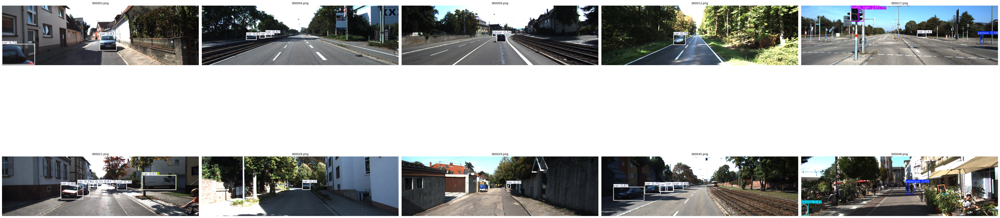

In [8]:
import os
import cv2 as cv
import matplotlib.pyplot as plt

# Define inference output directory
INFERENCE_IMAGES_PATH = '/kaggle/working/runs_n/yolov11n_kitti_inference/images'

# Get list of image files (up to 10)
image_files = sorted([f for f in os.listdir(INFERENCE_IMAGES_PATH) if f.endswith('.png')])[:10]

# Check if images exist
if not image_files:
    raise FileNotFoundError(f"No images found in {INFERENCE_IMAGES_PATH}")
elif len(image_files) < 10:
    print(f"Warning: Only {len(image_files)} images found in {INFERENCE_IMAGES_PATH}")

# Set up plot
fig, axes = plt.subplots(2, 5, figsize=(50, 20))
axes = axes.flatten()  # Flatten for easier iteration

# Load and display each image
for i, img_file in enumerate(image_files):
    img_path = os.path.join(INFERENCE_IMAGES_PATH, img_file)
    img = cv.imread(img_path)
    if img is None:
        print(f"Failed to load image: {img_path}")
        continue
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    
    axes[i].imshow(img_rgb)
    axes[i].set_title(img_file, fontsize=10)
    axes[i].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.show()

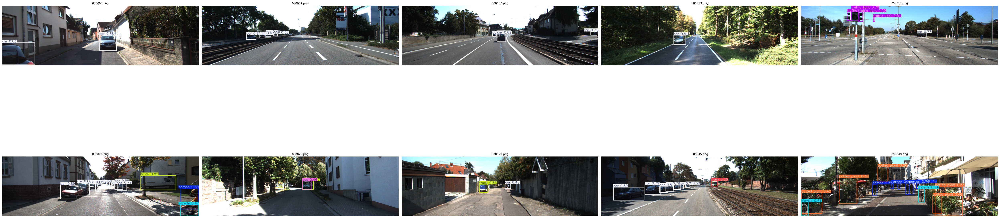

In [9]:
import os
import cv2 as cv
import matplotlib.pyplot as plt

# Define inference output directory
INFERENCE_IMAGES_PATH = '/kaggle/working/runs_m/yolov11m_kitti_inference/images'

# Get list of image files (up to 10)
image_files = sorted([f for f in os.listdir(INFERENCE_IMAGES_PATH) if f.endswith('.png')])[:10]

# Check if images exist
if not image_files:
    raise FileNotFoundError(f"No images found in {INFERENCE_IMAGES_PATH}")
elif len(image_files) < 10:
    print(f"Warning: Only {len(image_files)} images found in {INFERENCE_IMAGES_PATH}")

# Set up plot
fig, axes = plt.subplots(2, 5, figsize=(50, 20))
axes = axes.flatten()  # Flatten for easier iteration

# Load and display each image
for i, img_file in enumerate(image_files):
    img_path = os.path.join(INFERENCE_IMAGES_PATH, img_file)
    img = cv.imread(img_path)
    if img is None:
        print(f"Failed to load image: {img_path}")
        continue
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    
    axes[i].imshow(img_rgb)
    axes[i].set_title(img_file, fontsize=10)
    axes[i].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.show()

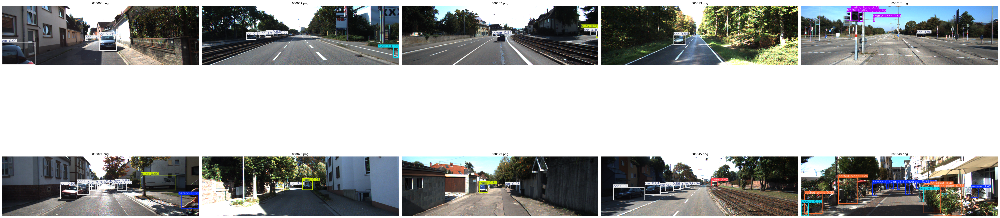

In [11]:
import os
import cv2 as cv
import matplotlib.pyplot as plt

# Define inference output directory
INFERENCE_IMAGES_PATH = '/kaggle/working/runs_x/yolov11x_kitti_inference/images'

# Get list of image files (up to 10)
image_files = sorted([f for f in os.listdir(INFERENCE_IMAGES_PATH) if f.endswith('.png')])[:10]

# Check if images exist
if not image_files:
    raise FileNotFoundError(f"No images found in {INFERENCE_IMAGES_PATH}")
elif len(image_files) < 10:
    print(f"Warning: Only {len(image_files)} images found in {INFERENCE_IMAGES_PATH}")

# Set up plot
fig, axes = plt.subplots(2, 5, figsize=(50, 20))
axes = axes.flatten()  # Flatten for easier iteration

# Load and display each image
for i, img_file in enumerate(image_files):
    img_path = os.path.join(INFERENCE_IMAGES_PATH, img_file)
    img = cv.imread(img_path)
    if img is None:
        print(f"Failed to load image: {img_path}")
        continue
    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    
    axes[i].imshow(img_rgb)
    axes[i].set_title(img_file, fontsize=10)
    axes[i].axis('off')

# Adjust layout and display
plt.tight_layout()
plt.show()

In [5]:
import shutil
import os

# Define the directory to delete
directory_to_delete = "/kaggle/working/runs_n"

# Check current contents of /kaggle/working
print("Current contents of /kaggle/working:")
os.system("ls /kaggle/working")

# Check if the directory exists and delete it
if os.path.exists(directory_to_delete):
    print(f"Deleting directory: {directory_to_delete}")
    shutil.rmtree(directory_to_delete)
    print(f"Directory {directory_to_delete} deleted successfully")
else:
    print(f"Directory {directory_to_delete} does not exist")

# Verify deletion
print("\nCurrent contents of /kaggle/working after deletion:")
os.system("ls /kaggle/working")

Current contents of /kaggle/working:
runs_n
yolo11n.pt
Deleting directory: /kaggle/working/runs_n
Directory /kaggle/working/runs_n deleted successfully

Current contents of /kaggle/working after deletion:
yolo11n.pt


0

In [7]:
import os
import cv2
import numpy as np
from ultralytics import YOLO
from pathlib import Path
from sklearn.metrics import precision_recall_fscore_support
from tqdm import tqdm
import yaml
import pandas as pd
import matplotlib.pyplot as plt
import shutil

# Define paths
KAGGLE_WORKING_PATH = "/kaggle/working/kitti_yolo"
SPLIT_DATA_PATH = "/kaggle/working/kitti_yolo_split"
TRAIN_IMAGES_PATH = os.path.join(SPLIT_DATA_PATH, "images", "train")
VAL_IMAGES_PATH = os.path.join(SPLIT_DATA_PATH, "images", "val")
TRAIN_LABELS_PATH = os.path.join(SPLIT_DATA_PATH, "labels", "train")
VAL_LABELS_PATH = os.path.join(SPLIT_DATA_PATH, "labels", "val")
KITTI_LABELS_PATH = "/kaggle/input/kitti-dataset/data_object_label_2/training/label_2"
OUTPUT_DIR = KAGGLE_WORKING_PATH
MODEL_PATH = "yolo11n.pt"
TRAIN_OUTPUT_DIR = os.path.join(OUTPUT_DIR, "train")
TRAINED_MODEL_PATH = os.path.join(TRAIN_OUTPUT_DIR, "weights", "best.pt")
PLOTS_DIR = os.path.join(OUTPUT_DIR, "train_p", "plots")
TEMP_LABELS_DIR = os.path.join(OUTPUT_DIR, "temp_labels")

# Create output directories
os.makedirs(os.path.join(OUTPUT_DIR, "val"), exist_ok=True)
os.makedirs(PLOTS_DIR, exist_ok=True)
os.makedirs(TEMP_LABELS_DIR, exist_ok=True)

def clear_train_directory(train_dir):
    if os.path.exists(train_dir):
        print(f"Clearing existing training directory: {train_dir}")
        shutil.rmtree(train_dir)
    os.makedirs(train_dir, exist_ok=True)

def clear_cache_files():
    cache_files = [
        os.path.join(SPLIT_DATA_PATH, "labels", "train.cache"),
        os.path.join(SPLIT_DATA_PATH, "labels", "val.cache")
    ]
    for cache_file in cache_files:
        if os.path.exists(cache_file):
            print(f"Removing cache file: {cache_file}")
            os.remove(cache_file)

def convert_kitti_to_yolo(kitti_label_path, yolo_label_path, img_width=1242, img_height=375):
    if not os.path.exists(kitti_label_path):
        print(f"Input label file not found: {kitti_label_path}")
        with open(yolo_label_path, 'w') as f:
            f.write('')
        return
    try:
        with open(kitti_label_path, 'r') as f:
            lines = f.readlines()
    except Exception as e:
        print(f"Error reading {kitti_label_path}: {e}")
        with open(yolo_label_path, 'w') as f:
            f.write('')
        return
    
    yolo_labels = []
    for line in lines:
        parts = line.strip().split()
        if len(parts) < 8:
            print(f"Skipping invalid line in {kitti_label_path}: {line.strip()}")
            continue
        class_name = parts[0].lower()
        class_id = (
            0 if class_name == 'car' else
            1 if class_name == 'van' else
            2 if class_name == 'truck' else
            3 if class_name == 'pedestrian' else
            4 if class_name == 'person_sitting' else
            5 if class_name == 'cyclist' else
            6 if class_name == 'tram' else
            7 if class_name == 'misc' else
            -1  # Ignore 'dontcare'
        )
        if class_id == -1:
            continue
        try:
            x_min, y_min, x_max, y_max = map(float, parts[4:8])
            width = x_max - x_min
            height = y_max - y_min
            if width <= 0 or height <= 0:
                print(f"Invalid bbox in {kitti_label_path}: width={width}, height={height}")
                continue
            x_center = x_min + width / 2
            y_center = y_min + height / 2
            x_center /= img_width
            y_center /= img_height
            width /= img_width
            height /= img_height
            yolo_labels.append(f"{class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}")
        except ValueError as e:
            print(f"Error parsing line in {kitti_label_path}: {line.strip()} - {e}")
            continue
    
    with open(yolo_label_path, 'w') as f:
        f.write('\n'.join(yolo_labels))
    if not yolo_labels:
        print(f"No valid labels generated for {kitti_label_path}")

def convert_dataset_labels():
    for split, img_path, label_path, split_name in [
        ('train', TRAIN_IMAGES_PATH, TRAIN_LABELS_PATH, 'train'),
        ('val', VAL_IMAGES_PATH, VAL_LABELS_PATH, 'val')
    ]:
        print(f"Converting labels for {split_name} split...")
        os.makedirs(label_path, exist_ok=True)
        image_files = sorted([f for f in os.listdir(img_path) if f.endswith('.png')])
        kitti_label_files = sorted([f for f in os.listdir(KITTI_LABELS_PATH) if f.endswith('.txt')])
        image_to_label = {f.replace('.png', '.txt'): f for f in image_files}
        
        for img_file in tqdm(image_files, desc=f"Processing {split_name} labels"):
            label_file = img_file.replace('.png', '.txt')
            kitti_label_file = label_file
            temp_label_path = os.path.join(TEMP_LABELS_DIR, f"{split_name}_{label_file}")
            final_label_path = os.path.join(label_path, label_file)
            
            if kitti_label_file in kitti_label_files:
                convert_kitti_to_yolo(
                    os.path.join(KITTI_LABELS_PATH, kitti_label_file),
                    temp_label_path
                )
                # Move to final location
                shutil.move(temp_label_path, final_label_path)
            else:
                print(f"No KITTI label for {img_file}, creating empty label")
                with open(final_label_path, 'w') as f:
                    f.write('')

def validate_labels(label_path, split_name):
    label_files = sorted([f for f in os.listdir(label_path) if f.endswith('.txt')])
    empty_files = 0
    total_labels = 0
    for label_file in label_files:
        with open(os.path.join(label_path, label_file), 'r') as f:
            lines = f.readlines()
        if not lines or all(line.strip() == '' for line in lines):
            empty_files += 1
        total_labels += len(lines)
    print(f"{split_name} labels: {len(label_files)} files, {empty_files} empty, {total_labels} total annotations")
    return empty_files, total_labels

def create_kitti_yaml():
    kitti_yaml = {
        "path": SPLIT_DATA_PATH,
        "train": "images/train",
        "val": "images/val",
        "names": {
            0: "car",
            1: "van",
            2: "truck",
            3: "pedestrian",
            4: "person_sitting",
            5: "cyclist",
            6: "tram",
            7: "misc"
        }
    }
    yaml_path = os.path.join(OUTPUT_DIR, "kitti.yaml")
    with open(yaml_path, "w") as f:
        yaml.dump(kitti_yaml, f)
    return yaml_path

def load_kitti_labels(label_path):
    labels = []
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                try:
                    class_id, x_center, y_center, width, height = map(float, parts)
                    if class_id in [0, 1, 2, 3, 4, 5, 6, 7]:
                        labels.append([int(class_id), x_center, y_center, width, height])
                except ValueError:
                    continue
    return np.array(labels)

def calculate_iou(box1, box2):
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    x1_min, y1_min = x1 - w1 / 2, y1 - h1 / 2
    x1_max, y1_max = x1 + w1 / 2, y1 + h1 / 2
    x2_min, y2_min = x2 - w2 / 2, y2 - h2 / 2
    x2_max, y2_max = x2 + w2 / 2, y2 + h2 / 2
    inter_x_min = max(x1_min, x2_min)
    inter_y_min = max(y1_min, y2_min)
    inter_x_max = min(x1_max, x2_max)
    inter_y_max = min(y1_max, y2_max)
    inter_area = max(0, inter_x_max - inter_x_min) * max(0, inter_y_max - inter_y_min)
    union_area = (w1 * h1) + (w2 * h2) - inter_area
    return inter_area / union_area if union_area > 0 else 0

def evaluate_predictions(predictions, ground_truths, iou_threshold=0.5):
    class_metrics = {
        0: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        1: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        2: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        3: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        4: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        5: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        6: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        7: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0}
    }
    for pred, gt in zip(predictions, ground_truths):
        pred_boxes = pred['boxes'] if pred else []
        gt_boxes = gt
        for class_id in class_metrics:
            pred_cls = [p for p in pred_boxes if p[0] == class_id]
            gt_cls = [g for g in gt_boxes if g[0] == class_id]
            class_metrics[class_id]['pred_count'] += len(pred_cls)
            class_metrics[class_id]['gt_count'] += len(gt_cls)
            matched = set()
            for i, pb in enumerate(pred_cls):
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_cls):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_threshold and max_idx not in matched:
                    class_metrics[class_id]['tp'] += 1
                    matched.add(max_idx)
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(class_id)
                else:
                    class_metrics[class_id]['fp'] += 1
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(-1)
            class_metrics[class_id]['fn'] += len(gt_cls) - len(matched)
            for j, gb in enumerate(gt_cls):
                if j not in matched:
                    class_metrics[class_id]['gts'].append(class_id)
                    class_metrics[class_id]['preds'].append(-1)
    metrics = {}
    for class_id, data in class_metrics.items():
        precision, recall, f1, _ = precision_recall_fscore_support(
            data['gts'], data['preds'], average='macro', zero_division=0
        )
        metrics[class_id] = {
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'mAP': calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold),
            'pred_count': data['pred_count'],
            'gt_count': data['gt_count']
        }
    all_precisions = [m['precision'] for m in metrics.values()]
    all_recalls = [m['recall'] for m in metrics.values()]
    all_f1s = [m['f1'] for m in metrics.values()]
    all_maps = [m['mAP'] for m in metrics.values()]
    overall = {
        'precision': np.mean(all_precisions),
        'recall': np.mean(all_recalls),
        'f1': np.mean(all_f1s),
        'mAP': np.mean(all_maps)
    }
    return metrics, overall

def calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold=0.5):
    precisions, recalls = [], []
    for iou_th in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = 0, 0, 0
        for pred, gt in zip(predictions, ground_truths):
            pred_boxes = [p for p in (pred['boxes'] if pred else []) if p[0] == class_id]
            gt_boxes = [g for g in gt if g[0] == class_id]
            matched = set()
            for pb in pred_boxes:
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_boxes):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_th and max_idx not in matched:
                    tp += 1
                    matched.add(max_idx)
                else:
                    fp += 1
            fn += len(gt_boxes) - len(matched)
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)
    if precisions and recalls:
        precisions = np.array(precisions)
        recalls = np.array(recalls)
        sorted_idx = np.argsort(recalls)
        precisions = precisions[sorted_idx]
        recalls = recalls[sorted_idx]
        for i in range(len(precisions) - 2, -1, -1):
            precisions[i] = max(precisions[i], precisions[i + 1])
        ap = np.trapz(precisions, recalls) if recalls.size > 1 else 0
        ap = max(0, ap)
    else:
        ap = 0
    return ap

def plot_training_curves(results_csv, output_dir):
    df = pd.read_csv(results_csv)
    columns = [
        'epoch',
        'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
        'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)',
        'val/box_loss', 'val/cls_loss', 'val/dfl_loss'
    ]
    if not all(col in df.columns for col in columns):
        print(f"Warning: results.csv missing expected columns. Found: {df.columns}")
        return
    epochs = df['epoch'].values + 1
    plt.figure(figsize=(12, 6))
    plt.plot(epochs, df['train/box_loss'], label='Train Box Loss', color='blue')
    plt.plot(epochs, df['val/box_loss'], label='Val Box Loss', color='cyan')
    plt.plot(epochs, df['train/cls_loss'], label='Train Cls Loss', color='red')
    plt.plot(epochs, df['val/cls_loss'], label='Val Cls Loss', color='pink')
    plt.plot(epochs, df['train/dfl_loss'], label='Train DFL Loss', color='green')
    plt.plot(epochs, df['val/dfl_loss'], label='Val DFL Loss', color='lime')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Losses')
    plt.legend()
    plt.grid(True)
    plt.savefig(os.path.join(output_dir, 'losses.png'))
    plt.close()
    plt.figure(figsize=(12, 6))
    plt.plot(epochs, df['metrics/precision(B)'], label='Precision', color='blue')
    plt.plot(epochs, df['metrics/recall(B)'], label='Recall', color='red')
    plt.plot(epochs, df['metrics/mAP50(B)'], label='mAP@0.5', color='green')
    plt.plot(epochs, df['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', color='purple')
    plt.xlabel('Epoch')
    plt.ylabel('Metric Value')
    plt.title('Validation Metrics')
    plt.legend()
    plt.grid(True)
    plt.savefig(os.path.join(output_dir, 'metrics.png'))
    plt.close()
    print(f"Training curves saved to {output_dir}")

def main():
    train_files = sorted([f for f in os.listdir(TRAIN_IMAGES_PATH) if f.endswith('.png')])
    val_files = sorted([f for f in os.listdir(VAL_IMAGES_PATH) if f.endswith('.png')])
    print(f"Using existing splits: Train: {len(train_files)} images, Val: {len(val_files)} images")
    clear_train_directory(TRAIN_OUTPUT_DIR)
    clear_cache_files()
    print("Converting KITTI labels to YOLO format...")
    convert_dataset_labels()
    print("Label conversion completed.")
    print("Validating labels...")
    train_empty, train_total = validate_labels(TRAIN_LABELS_PATH, "Train")
    val_empty, val_total = validate_labels(VAL_LABELS_PATH, "Val")
    if train_empty == len(train_files) or val_empty == len(val_files):
        print("Error: All label files are empty. Check KITTI label files.")
        return
    print("Creating kitti.yaml...")
    yaml_path = create_kitti_yaml()
    print(f"kitti.yaml created at {yaml_path}")
    model = YOLO(MODEL_PATH)
    print(f"Loaded YOLOv11 model: {MODEL_PATH}")
    print("Starting fine-tuning on KITTI dataset...")
    model.train(
        data=yaml_path,
        epochs=120,
        imgsz=640,
        batch=16,
        device=0,
        project=OUTPUT_DIR,
        name="train",
        patience=10,
        lr0=0.001,
        optimizer="AdamW",
        cos_lr=True,
        freeze=10,
        hsv_h=0.015,
        hsv_s=0.7,
        hsv_v=0.4,
        degrees=15.0,
        translate=0.1,
        scale=0.5,
        mosaic=1.0,
        exist_ok=True
    )
    print("Fine-tuning completed.")
    results_csv = os.path.join(TRAIN_OUTPUT_DIR, "results.csv")
    if os.path.exists(results_csv):
        plot_training_curves(results_csv, PLOTS_DIR)
    else:
        print(f"Error: results.csv not found at {results_csv}")
    trained_model = YOLO(TRAINED_MODEL_PATH)
    print(f"Loaded trained model: {TRAINED_MODEL_PATH}")
    image_files = sorted([f for f in os.listdir(VAL_IMAGES_PATH) if f.endswith('.png')])
    predictions = []
    ground_truths = []
    for img_file in tqdm(image_files, desc="Running inference on validation set"):
        img_path = os.path.join(VAL_IMAGES_PATH, img_file)
        label_path = os.path.join(VAL_LABELS_PATH, img_file.replace('.png', '.txt'))
        img = cv2.imread(img_path)
        if img is None:
            print(f"Failed to load image: {img_path}")
            continue
        results = trained_model.predict(img_path, conf=0.5, iou=0.7, verbose=False)
        pred_boxes = []
        for result in results:
            boxes = result.boxes
            for box, cls, conf in zip(boxes.xywhn, boxes.cls, boxes.conf):
                class_id = int(cls)
                if class_id in [0, 1, 2, 3, 4, 5, 6, 7]:
                    pred_boxes.append([class_id, float(box[0]), float(box[1]), float(box[2]), float(box[3])])
        predictions.append({'boxes': pred_boxes})
        gt_boxes = load_kitti_labels(label_path)
        ground_truths.append(gt_boxes)
        result_img = results[0].plot()
        cv2.imwrite(os.path.join(OUTPUT_DIR, "val", img_file), result_img)
    class_metrics, overall_metrics = evaluate_predictions(predictions, ground_truths, iou_threshold=0.5)
    class_names = {0: 'Car', 1: 'Van', 2: 'Truck', 3: 'Pedestrian', 4: 'Person_sitting', 5: 'Cyclist', 6: 'Tram', 7: 'Misc'}
    print("\nPerformance Metrics on KITTI Validation Set (Fine-Tuned Model):")
    for class_id, metrics in class_metrics.items():
        print(f"Class: {class_names[class_id]}")
        print(f"  Precision: {metrics['precision']:.4f}")
        print(f"  Recall: {metrics['recall']:.4f}")
        print(f"  F1 Score: {metrics['f1']:.4f}")
        print(f"  mAP@0.5: {metrics['mAP']:.4f}")
        print(f"  Predicted Instances: {metrics['pred_count']}")
        print(f"  Ground Truth Instances: {metrics['gt_count']}")
    print("Overall (Macro-Average):")
    print(f"  Precision: {overall_metrics['precision']:.4f}")
    print(f"  Recall: {overall_metrics['recall']:.4f}")
    print(f"  F1 Score: {overall_metrics['f1']:.4f}")
    print(f"  mAP@0.5: {overall_metrics['mAP']:.4f}")

if __name__ == "__main__":
    main()

Using existing splits: Train: 5236 images, Val: 748 images
Converting KITTI labels to YOLO format...
Converting labels for train split...


Processing train labels: 100%|██████████| 5236/5236 [00:07<00:00, 714.87it/s]


Converting labels for val split...


Processing val labels: 100%|██████████| 748/748 [00:00<00:00, 750.42it/s]


Label conversion completed.
Validating labels...
Train labels: 5236 files, 0 empty, 28396 total annotations
Val labels: 748 files, 0 empty, 4207 total annotations
Creating kitti.yaml...
kitti.yaml created at /kaggle/working/kitti_yolo/kitti.yaml
Loaded YOLOv11 model: yolo11n.pt
Starting fine-tuning on KITTI dataset...
Ultralytics 8.3.139 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/kaggle/working/kitti_yolo/kitti.yaml, degrees=15.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=120, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=10, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.

100%|██████████| 755k/755k [00:00<00:00, 31.9MB/s]


Overriding model.yaml nc=80 with nc=8

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /kaggle/working/kitti_yolo_split/labels/train... 5236 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5236/5236 [00:25<00:00, 201.61it/s]


train: New cache created: /kaggle/working/kitti_yolo_split/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2527.1±1840.9 MB/s, size: 827.6 KB)


val: Scanning /kaggle/working/kitti_yolo_split/labels/val... 748 images, 0 backgrounds, 0 corrupt: 100%|██████████| 748/748 [00:03<00:00, 214.80it/s]

val: New cache created: /kaggle/working/kitti_yolo_split/labels/val.cache


Plotting labels to /kaggle/working/kitti_yolo/train/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to /kaggle/working/kitti_yolo/train
Starting training for 120 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/120      1.46G      1.592      1.627       1.22         32        640: 100%|██████████| 328/328 [00:59<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:05<00:00,  4.00it/s]


                   all        748       4207      0.505      0.295        0.3      0.155

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/120      1.46G      1.444      1.239      1.169         32        640: 100%|██████████| 328/328 [00:56<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.03it/s]


                   all        748       4207      0.466      0.379      0.387      0.207

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/120      1.46G      1.403      1.158      1.152         58        640: 100%|██████████| 328/328 [00:56<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.34it/s]


                   all        748       4207      0.516      0.411      0.416      0.231

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/120      1.46G      1.365      1.091      1.136         39        640: 100%|██████████| 328/328 [00:56<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.59it/s]

                   all        748       4207       0.57      0.433      0.455      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/120      1.46G      1.335      1.062      1.123         50        640: 100%|██████████| 328/328 [00:57<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.39it/s]

                   all        748       4207      0.555      0.445       0.48      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/120      1.46G       1.32      1.029      1.116         38        640: 100%|██████████| 328/328 [00:57<00:00,  5.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.44it/s]

                   all        748       4207      0.579      0.474      0.518      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/120      1.46G      1.284     0.9945      1.103         33        640: 100%|██████████| 328/328 [00:57<00:00,  5.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.54it/s]


                   all        748       4207      0.527      0.501        0.5      0.288

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/120      1.46G      1.267     0.9684      1.094         49        640: 100%|██████████| 328/328 [00:57<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.18it/s]


                   all        748       4207      0.563      0.514      0.541      0.311

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/120      1.46G      1.263     0.9524      1.091         79        640: 100%|██████████| 328/328 [00:56<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.53it/s]


                   all        748       4207      0.682      0.484      0.583       0.33

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/120      1.46G      1.242     0.9328       1.08         27        640: 100%|██████████| 328/328 [00:57<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.50it/s]


                   all        748       4207      0.603      0.531      0.571      0.336

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/120      1.46G      1.234      0.917      1.077         23        640: 100%|██████████| 328/328 [00:56<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.11it/s]

                   all        748       4207      0.713      0.515      0.605      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/120      1.46G      1.223     0.9122       1.07         31        640: 100%|██████████| 328/328 [00:56<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  4.96it/s]


                   all        748       4207       0.64      0.526      0.591      0.345

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/120      1.46G      1.206     0.8964      1.069         47        640: 100%|██████████| 328/328 [00:56<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.20it/s]


                   all        748       4207       0.63      0.546      0.588      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/120      1.46G      1.211     0.8934      1.068         29        640: 100%|██████████| 328/328 [00:56<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.23it/s]

                   all        748       4207      0.635      0.579      0.615       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/120      1.46G      1.191      0.874      1.059         20        640: 100%|██████████| 328/328 [00:56<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.41it/s]

                   all        748       4207      0.697      0.527      0.608      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/120      1.46G      1.178     0.8573      1.053         34        640: 100%|██████████| 328/328 [00:57<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.42it/s]


                   all        748       4207      0.703      0.566      0.641      0.375

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/120      1.46G      1.175     0.8571      1.051         91        640: 100%|██████████| 328/328 [00:57<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.58it/s]


                   all        748       4207      0.686       0.62      0.664      0.392

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/120      1.46G      1.167       0.84      1.048         48        640: 100%|██████████| 328/328 [00:57<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.59it/s]


                   all        748       4207      0.734      0.584      0.665      0.399

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/120      1.46G      1.167     0.8359      1.048         37        640: 100%|██████████| 328/328 [00:56<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.60it/s]

                   all        748       4207      0.629      0.615      0.653      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/120      1.46G      1.152     0.8291      1.041         47        640: 100%|██████████| 328/328 [00:56<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.60it/s]

                   all        748       4207      0.669      0.603      0.658       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/120      1.46G      1.147      0.821      1.037         39        640: 100%|██████████| 328/328 [00:55<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.25it/s]

                   all        748       4207      0.709      0.591       0.67      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/120      1.46G      1.142     0.8146       1.04         45        640: 100%|██████████| 328/328 [00:55<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  4.92it/s]


                   all        748       4207      0.725      0.622      0.697      0.409

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/120      1.46G      1.138     0.8131      1.033         61        640: 100%|██████████| 328/328 [00:56<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.66it/s]

                   all        748       4207      0.739      0.623      0.699      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/120      1.46G      1.141     0.8057      1.035         62        640: 100%|██████████| 328/328 [00:56<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.54it/s]


                   all        748       4207      0.689      0.643      0.701      0.421

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/120      1.46G      1.133      0.801      1.029         55        640: 100%|██████████| 328/328 [00:56<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.52it/s]

                   all        748       4207      0.723      0.641      0.712      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/120      1.46G      1.124     0.7908      1.027         45        640: 100%|██████████| 328/328 [00:56<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.72it/s]

                   all        748       4207      0.714      0.638       0.71      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/120      1.46G      1.118     0.7911      1.024         26        640: 100%|██████████| 328/328 [00:56<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.52it/s]


                   all        748       4207      0.734      0.632      0.708      0.421

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/120      1.46G      1.118     0.7835      1.025         53        640: 100%|██████████| 328/328 [00:57<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.07it/s]

                   all        748       4207      0.753      0.646      0.724      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/120      1.46G      1.114     0.7815       1.02         22        640: 100%|██████████| 328/328 [00:57<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.56it/s]


                   all        748       4207      0.759      0.627      0.719      0.444

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/120      1.46G       1.11     0.7773      1.021         52        640: 100%|██████████| 328/328 [00:57<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.71it/s]

                   all        748       4207       0.77      0.614      0.713      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/120      1.46G      1.101     0.7681      1.017         49        640: 100%|██████████| 328/328 [00:55<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  4.94it/s]

                   all        748       4207      0.715      0.675      0.729      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/120      1.46G      1.102     0.7706      1.018         23        640: 100%|██████████| 328/328 [00:56<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.64it/s]


                   all        748       4207      0.727      0.646      0.731      0.445

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/120      1.46G      1.097     0.7631      1.017         55        640: 100%|██████████| 328/328 [00:56<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.67it/s]


                   all        748       4207      0.805      0.613      0.723      0.436

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/120      1.46G       1.09     0.7599      1.011         63        640: 100%|██████████| 328/328 [00:56<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.41it/s]

                   all        748       4207       0.76      0.647      0.728      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/120      1.46G      1.083     0.7484      1.008         36        640: 100%|██████████| 328/328 [00:56<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.52it/s]


                   all        748       4207      0.775      0.659      0.741      0.463

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/120      1.46G      1.082     0.7477      1.009         43        640: 100%|██████████| 328/328 [00:56<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.45it/s]

                   all        748       4207       0.74      0.663       0.73      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/120      1.46G      1.086     0.7499      1.011         62        640: 100%|██████████| 328/328 [00:56<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.53it/s]

                   all        748       4207      0.793      0.638      0.736      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/120      1.46G      1.079     0.7477      1.008         52        640: 100%|██████████| 328/328 [00:56<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.69it/s]

                   all        748       4207      0.706      0.682      0.729      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/120      1.46G      1.078     0.7404      1.006         42        640: 100%|██████████| 328/328 [00:56<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  4.83it/s]


                   all        748       4207      0.742      0.677      0.747      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/120      1.46G      1.071     0.7338      1.004         55        640: 100%|██████████| 328/328 [00:57<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:05<00:00,  4.78it/s]


                   all        748       4207      0.787      0.667      0.753      0.469

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/120      1.46G      1.064     0.7306     0.9997         58        640: 100%|██████████| 328/328 [00:56<00:00,  5.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.32it/s]


                   all        748       4207      0.752      0.704      0.753      0.468

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/120      1.46G      1.069     0.7358      1.003         26        640: 100%|██████████| 328/328 [00:56<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.56it/s]

                   all        748       4207      0.806      0.646       0.75      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/120      1.46G      1.064     0.7303     0.9986         63        640: 100%|██████████| 328/328 [00:56<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.64it/s]

                   all        748       4207      0.761      0.682      0.763      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/120      1.46G       1.06     0.7283      1.001         84        640: 100%|██████████| 328/328 [00:55<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.65it/s]

                   all        748       4207      0.718      0.701      0.759      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/120      1.46G      1.057     0.7218     0.9985         64        640: 100%|██████████| 328/328 [00:57<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.28it/s]

                   all        748       4207      0.786      0.662      0.761      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/120      1.46G      1.053     0.7153     0.9971         44        640: 100%|██████████| 328/328 [00:56<00:00,  5.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.21it/s]

                   all        748       4207      0.772      0.664      0.762      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/120      1.46G      1.052     0.7153     0.9949         46        640: 100%|██████████| 328/328 [00:57<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.45it/s]


                   all        748       4207      0.814       0.67      0.767      0.483

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/120      1.46G      1.044     0.7078     0.9928         42        640: 100%|██████████| 328/328 [00:56<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.43it/s]

                   all        748       4207      0.765      0.702      0.776      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/120      1.46G      1.039      0.703     0.9903         38        640: 100%|██████████| 328/328 [00:56<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  4.88it/s]

                   all        748       4207      0.776      0.692       0.77      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/120      1.46G      1.044     0.7068     0.9928         38        640: 100%|██████████| 328/328 [00:56<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.15it/s]


                   all        748       4207       0.81      0.671      0.769      0.491

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/120      1.46G      1.038     0.7039     0.9918         53        640: 100%|██████████| 328/328 [00:56<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.45it/s]

                   all        748       4207      0.789      0.665      0.766       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/120      1.46G      1.034      0.702     0.9858         35        640: 100%|██████████| 328/328 [00:56<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.59it/s]

                   all        748       4207      0.814      0.682       0.78      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/120      1.46G      1.034     0.6975     0.9873         78        640: 100%|██████████| 328/328 [00:56<00:00,  5.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.69it/s]

                   all        748       4207        0.8      0.688      0.776      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/120      1.46G      1.032     0.6989     0.9874         55        640: 100%|██████████| 328/328 [00:56<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.63it/s]

                   all        748       4207      0.777       0.72      0.794      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/120      1.46G      1.018     0.6887     0.9819         41        640: 100%|██████████| 328/328 [00:57<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.47it/s]

                   all        748       4207       0.78      0.707      0.793      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/120      1.46G      1.019     0.6872     0.9828         64        640: 100%|██████████| 328/328 [00:57<00:00,  5.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.54it/s]

                   all        748       4207       0.78      0.706      0.783      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/120      1.46G      1.019     0.6881     0.9816         47        640: 100%|██████████| 328/328 [00:56<00:00,  5.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.41it/s]

                   all        748       4207      0.803      0.697      0.784      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/120      1.46G      1.014     0.6844     0.9792         48        640: 100%|██████████| 328/328 [00:55<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:05<00:00,  4.68it/s]

                   all        748       4207      0.797      0.721      0.789      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/120      1.46G      1.014     0.6778     0.9774         55        640: 100%|██████████| 328/328 [00:55<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.52it/s]


                   all        748       4207      0.808      0.727      0.799      0.516

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/120      1.46G      1.012     0.6783     0.9797         11        640: 100%|██████████| 328/328 [00:55<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.58it/s]


                   all        748       4207      0.748      0.738      0.791      0.506

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/120      1.46G      1.007     0.6725     0.9777         46        640: 100%|██████████| 328/328 [00:56<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.65it/s]

                   all        748       4207      0.768      0.718      0.794      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/120      1.46G      1.007     0.6742     0.9782         53        640: 100%|██████████| 328/328 [00:55<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.65it/s]

                   all        748       4207      0.842      0.684        0.8      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/120      1.46G      1.004     0.6713     0.9753         31        640: 100%|██████████| 328/328 [00:56<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.65it/s]

                   all        748       4207      0.799      0.723      0.807      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/120      1.46G      1.001     0.6725     0.9771         50        640: 100%|██████████| 328/328 [00:55<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.61it/s]


                   all        748       4207      0.846      0.699      0.811      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/120      1.46G      1.001     0.6691     0.9737         31        640: 100%|██████████| 328/328 [00:55<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.32it/s]

                   all        748       4207      0.784      0.732      0.803      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/120      1.46G      1.001     0.6685     0.9743         48        640: 100%|██████████| 328/328 [00:55<00:00,  5.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:05<00:00,  4.80it/s]


                   all        748       4207      0.814      0.702      0.802      0.521

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/120      1.46G     0.9896     0.6653     0.9727         28        640: 100%|██████████| 328/328 [00:55<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.32it/s]


                   all        748       4207      0.828      0.704      0.806      0.526

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/120      1.46G     0.9984     0.6642      0.971         26        640: 100%|██████████| 328/328 [00:55<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.51it/s]


                   all        748       4207      0.789      0.731      0.806      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/120      1.46G     0.9934     0.6629     0.9713         22        640: 100%|██████████| 328/328 [00:56<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.59it/s]


                   all        748       4207      0.804       0.73      0.811      0.527

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/120      1.46G     0.9886     0.6556     0.9685         40        640: 100%|██████████| 328/328 [00:56<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.43it/s]

                   all        748       4207      0.811       0.72      0.807      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/120      1.46G     0.9843     0.6484     0.9664         45        640: 100%|██████████| 328/328 [00:56<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.72it/s]

                   all        748       4207      0.805      0.719      0.808      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/120      1.46G     0.9834     0.6527     0.9683         30        640: 100%|██████████| 328/328 [00:55<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.69it/s]

                   all        748       4207      0.788      0.751       0.81      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/120      1.46G      0.987     0.6559     0.9703         30        640: 100%|██████████| 328/328 [00:56<00:00,  5.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  5.56it/s]

                   all        748       4207      0.785      0.728      0.807      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/120      1.46G     0.9748     0.6425      0.964         39        640: 100%|██████████| 328/328 [00:56<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:04<00:00,  4.94it/s]

                   all        748       4207      0.821      0.706      0.808      0.529


EarlyStopping: Training stopped early as no improvement observed in last 10 epochs. Best results observed at epoch 64, best model saved as best.pt.
To update EarlyStopping(patience=10) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.

74 epochs completed in 1.263 hours.
Optimizer stripped from /kaggle/working/kitti_yolo/train/weights/last.pt, 5.4MB
Optimizer stripped from /kaggle/working/kitti_yolo/train/weights/best.pt, 5.4MB

Validating /kaggle/working/kitti_yolo/train/weights/best.pt...
Ultralytics 8.3.139 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO11n summary (fused): 100 layers, 2,583,712 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:05<00:00,  4.48it/s]


                   all        748       4207      0.843      0.701      0.811       0.53
                   car        676       2945      0.852      0.863      0.919      0.675
                   van        207        298      0.846      0.809      0.884      0.632
                 truck         99        106      0.921      0.906       0.97      0.745
            pedestrian        192        478      0.812      0.534      0.676      0.342
        person_sitting          9         32      0.935      0.449      0.701      0.393
               cyclist        133        202      0.809      0.624      0.745      0.419
                  tram         44         65      0.761      0.832      0.891      0.573
                  misc         64         81      0.807      0.593      0.699      0.457


/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.1ms preprocess, 0.9ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to /kaggle/working/kitti_yolo/train
Fine-tuning completed.
Training curves saved to /kaggle/working/kitti_yolo/train_p/plots
Loaded trained model: /kaggle/working/kitti_yolo/train/weights/best.pt


Running inference on validation set: 100%|██████████| 748/748 [00:45<00:00, 16.55it/s]



Performance Metrics on KITTI Validation Set (Fine-Tuned Model):
Class: Car
  Precision: 0.4723
  Recall: 0.3942
  F1 Score: 0.4298
  mAP@0.5: 0.6733
  Predicted Instances: 2458
  Ground Truth Instances: 2945
Class: Van
  Precision: 0.4567
  Recall: 0.3540
  F1 Score: 0.3989
  mAP@0.5: 0.5732
  Predicted Instances: 231
  Ground Truth Instances: 298
Class: Truck
  Precision: 0.4892
  Recall: 0.4292
  F1 Score: 0.4573
  mAP@0.5: 0.7662
  Predicted Instances: 93
  Ground Truth Instances: 106
Class: Pedestrian
  Precision: 0.4636
  Recall: 0.1998
  F1 Score: 0.2792
  mAP@0.5: 0.3666
  Predicted Instances: 206
  Ground Truth Instances: 478
Class: Person_sitting
  Precision: 0.5000
  Recall: 0.0938
  F1 Score: 0.1579
  mAP@0.5: 0.1875
  Predicted Instances: 6
  Ground Truth Instances: 32
Class: Cyclist
  Precision: 0.4685
  Recall: 0.2574
  F1 Score: 0.3323
  mAP@0.5: 0.4731
  Predicted Instances: 111
  Ground Truth Instances: 202
Class: Tram
  Precision: 0.4623
  Recall: 0.3769
  F1 Score: 

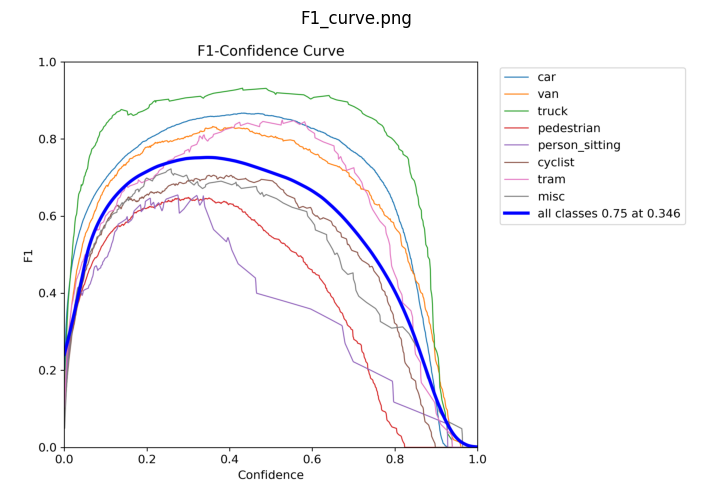

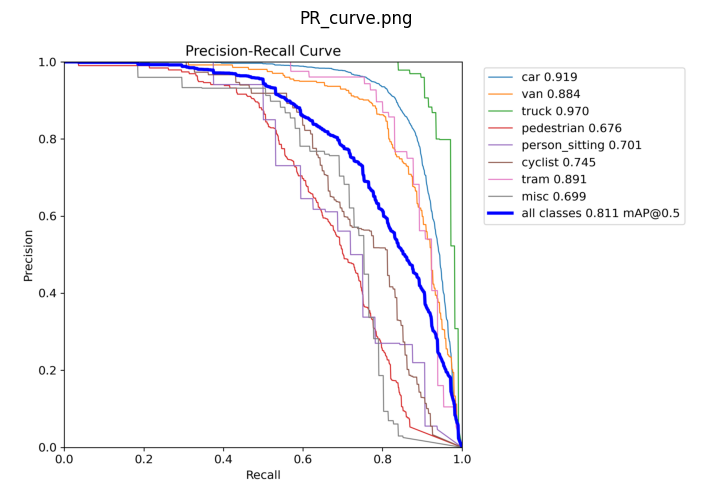

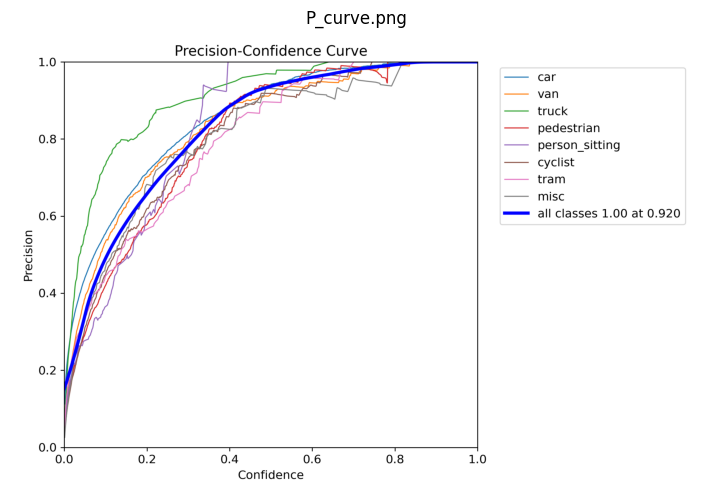

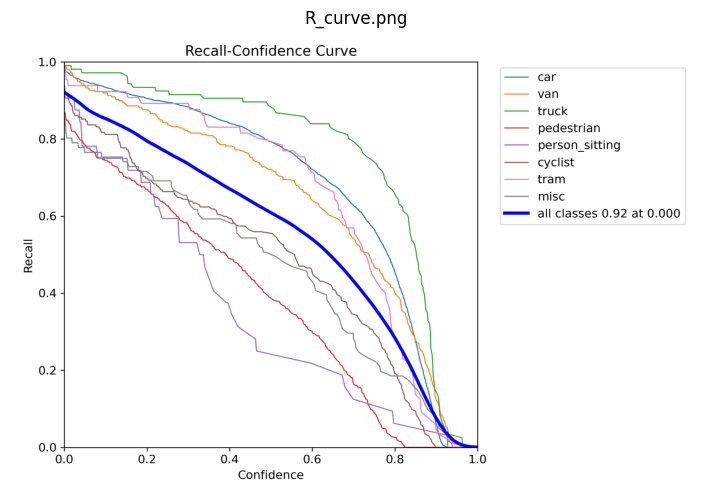

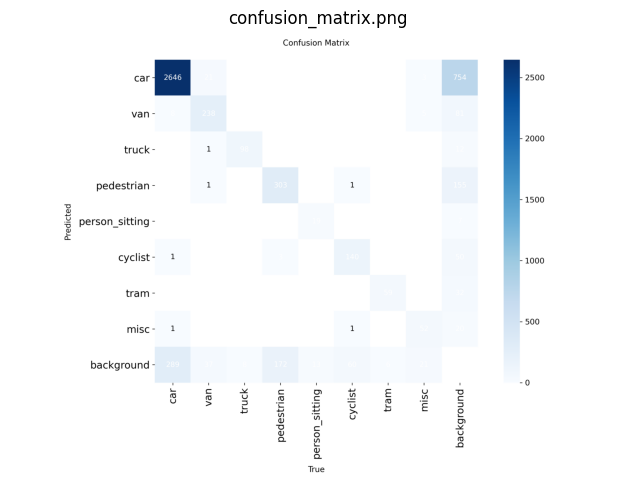

...

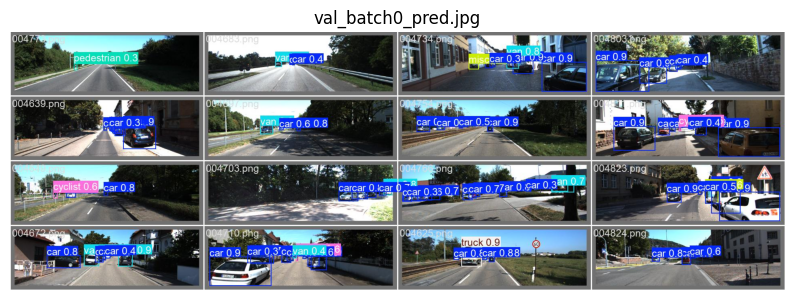

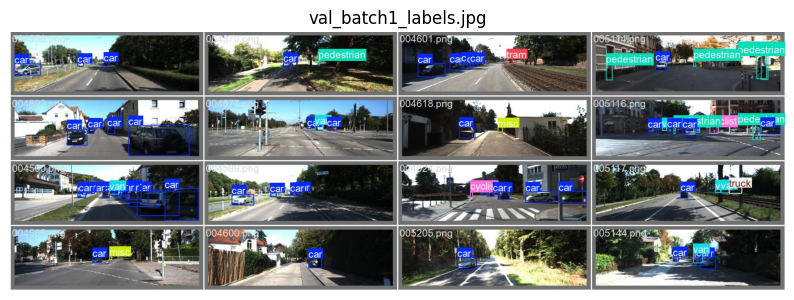

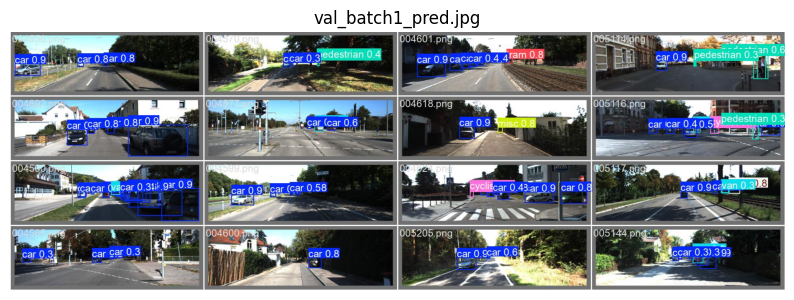

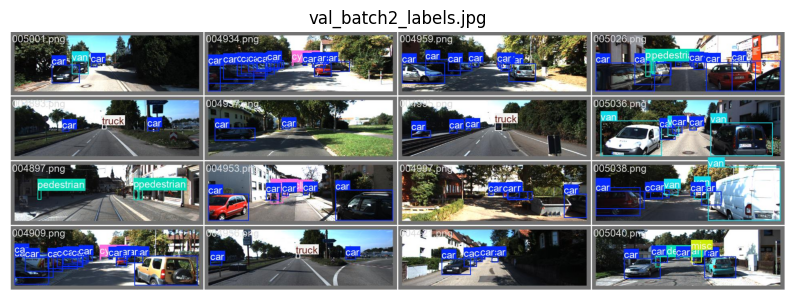

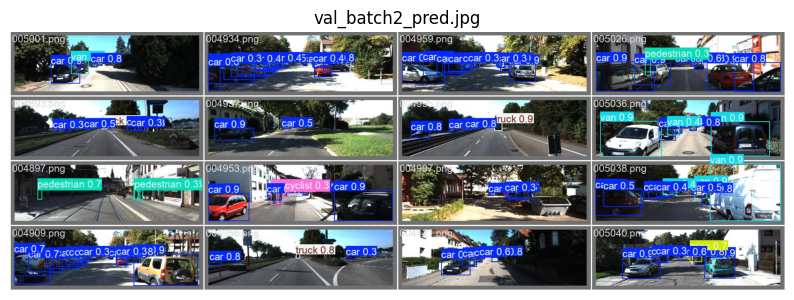

In [8]:
from pathlib import Path
import matplotlib.pyplot as plt
import cv2  # pip install opencv-python

FOLDER = "/kaggle/working/kitti_yolo/train"        # <-- put your folder here
EXTENSIONS = {".png", ".jpg", ".jpeg", ".bmp", ".tif"}   # image types to load

def show_images(folder_path, exts):
    folder = Path(folder_path)
    img_files = sorted([f for f in folder.iterdir() if f.suffix.lower() in exts])

    if not img_files:
        print("No images found in", folder)
        return

    for img_path in img_files:
        img_bgr = cv2.imread(str(img_path))          # OpenCV loads in BGR
        if img_bgr is None:
            print("Couldn’t read:", img_path)
            continue
        img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(10, 6))
        plt.imshow(img_rgb)
        plt.title(img_path.name)
        plt.axis('off')
        plt.show()

show_images(FOLDER, EXTENSIONS)

In [14]:
import os
import cv2
import numpy as np
from ultralytics import YOLO
from sklearn.metrics import precision_recall_fscore_support
from tqdm import tqdm
import shutil

# Define paths
KAGGLE_WORKING_PATH = "/kaggle/working/kitti_yolo"
SPLIT_DATA_PATH = "/kaggle/working/kitti_yolo_split"
TEST_IMAGES_PATH = os.path.join(SPLIT_DATA_PATH, "images", "test")
TEST_LABELS_PATH = os.path.join(SPLIT_DATA_PATH, "labels", "test_yolo")
KITTI_TEST_LABELS_PATH = os.path.join(SPLIT_DATA_PATH, "labels", "test")
TRAINED_MODEL_PATH = os.path.join(KAGGLE_WORKING_PATH, "train", "weights", "best.pt")
TEST_OUTPUT_DIR = os.path.join(KAGGLE_WORKING_PATH, "test")
TEMP_LABELS_DIR = os.path.join(KAGGLE_WORKING_PATH, "temp_labels")

# Create output directories
os.makedirs(TEST_OUTPUT_DIR, exist_ok=True)
os.makedirs(TEMP_LABELS_DIR, exist_ok=True)
os.makedirs(TEST_LABELS_PATH, exist_ok=True)

def convert_kitti_to_yolo(kitti_label_path, yolo_label_path, img_width=1242, img_height=375):
    if not os.path.exists(kitti_label_path):
        print(f"Input label file not found: {kitti_label_path}")
        with open(yolo_label_path, 'w') as f:
            f.write('')
        return {i: 0 for i in range(8)}
    try:
        with open(kitti_label_path, 'r') as f:
            lines = f.readlines()
    except Exception as e:
        print(f"Error reading {kitti_label_path}: {e}")
        with open(yolo_label_path, 'w') as f:
            f.write('')
        return {i: 0 for i in range(8)}
    
    class_mapping = {
        'car': 0,
        'van': 1,
        'truck': 2,
        'pedestrian': 3,
        'person_sitting': 4,
        'cyclist': 5,
        'tram': 6,
        'misc': 7
    }
    class_counts = {i: 0 for i in range(8)}
    yolo_labels = []
    for line in lines:
        parts = line.strip().split()
        if len(parts) < 8:
            print(f"Skipping invalid line in {kitti_label_path}: {line.strip()}")
            continue
        class_name = parts[0].lower()
        if class_name not in class_mapping or class_name == 'dontcare':
            continue
        class_id = class_mapping[class_name]
        try:
            x_min, y_min, x_max, y_max = map(float, parts[4:8])
            width = x_max - x_min
            height = y_max - y_min
            if width <= 0 or height <= 0:
                print(f"Invalid bbox in {kitti_label_path}: width={width}, height={height}")
                continue
            x_center = x_min + width / 2
            y_center = y_min + height / 2
            x_center /= img_width
            y_center /= img_height
            width /= img_width
            height /= img_height
            yolo_labels.append(f"{class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}")
            class_counts[class_id] += 1
        except ValueError as e:
            print(f"Error parsing line in {kitti_label_path}: {line.strip()} - {e}")
            continue
    
    with open(yolo_label_path, 'w') as f:
        f.write('\n'.join(yolo_labels) + '\n')
    if not yolo_labels:
        print(f"No valid labels generated for {kitti_label_path}")
    print(f"Label counts for {kitti_label_path}: {class_counts}")
    return class_counts

def convert_test_labels():
    print("Converting test labels to YOLO format...")
    image_files = sorted([f for f in os.listdir(TEST_IMAGES_PATH) if f.endswith('.png')])
    kitti_label_files = sorted([f for f in os.listdir(KITTI_TEST_LABELS_PATH) if f.endswith('.txt')])
    total_counts = {i: 0 for i in range(8)}
    for img_file in tqdm(image_files, desc="Processing test labels"):
        label_file = img_file.replace('.png', '.txt')
        temp_label_path = os.path.join(TEMP_LABELS_DIR, f"test_{label_file}")
        final_label_path = os.path.join(TEST_LABELS_PATH, label_file)
        
        if label_file in kitti_label_files:
            counts = convert_kitti_to_yolo(
                os.path.join(KITTI_TEST_LABELS_PATH, label_file),
                temp_label_path
            )
            shutil.move(temp_label_path, final_label_path)
            for class_id in total_counts:
                total_counts[class_id] += counts.get(class_id, 0)
        else:
            print(f"No KITTI label for {img_file}, creating empty label")
            with open(final_label_path, 'w') as f:
                f.write('')
    print(f"Total test label counts: {total_counts}")
    return total_counts

def validate_labels(label_path, split_name):
    label_files = sorted([f for f in os.listdir(label_path) if f.endswith('.txt')])
    empty_files = 0
    total_labels = 0
    for label_file in label_files:
        with open(os.path.join(label_path, label_file), 'r') as f:
            lines = f.readlines()
        if not lines or all(line.strip() == '' for line in lines):
            empty_files += 1
        total_labels += len(lines)
    print(f"{split_name} labels: {len(label_files)} files, {empty_files} empty, {total_labels} total annotations")
    return empty_files, total_labels

def load_kitti_labels(label_path):
    labels = []
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                try:
                    class_id, x_center, y_center, width, height = map(float, parts)
                    if class_id in range(8):
                        labels.append([int(class_id), x_center, y_center, width, height])
                except ValueError:
                    continue
    return np.array(labels)

def calculate_iou(box1, box2):
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    x1_min, y1_min = x1 - w1 / 2, y1 - h1 / 2
    x1_max, y1_max = x1 + w1 / 2, y1 + h1 / 2
    x2_min, y2_min = x2 - w2 / 2, y2 - h2 / 2
    x2_max, y2_max = x2 + w2 / 2, y2 + h2 / 2
    inter_x_min = max(x1_min, x2_min)
    inter_y_min = max(y1_min, y2_min)
    inter_x_max = min(x1_max, x2_max)
    inter_y_max = min(y1_max, y2_max)
    inter_area = max(0, inter_x_max - inter_x_min) * max(0, inter_y_max - inter_y_min)
    union_area = (w1 * h1) + (w2 * h2) - inter_area
    return inter_area / union_area if union_area > 0 else 0

def evaluate_predictions(predictions, ground_truths, iou_threshold=0.5):
    class_metrics = {
        i: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0}
        for i in range(8)
    }
    for pred, gt in zip(predictions, ground_truths):
        pred_boxes = pred['boxes'] if pred else []
        gt_boxes = gt
        for class_id in class_metrics:
            pred_cls = [p for p in pred_boxes if p[0] == class_id]
            gt_cls = [g for g in gt_boxes if g[0] == class_id]
            class_metrics[class_id]['pred_count'] += len(pred_cls)
            class_metrics[class_id]['gt_count'] += len(gt_cls)
            matched = set()
            for i, pb in enumerate(pred_cls):
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_cls):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_threshold and max_idx not in matched:
                    class_metrics[class_id]['tp'] += 1
                    matched.add(max_idx)
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(class_id)
                else:
                    class_metrics[class_id]['fp'] += 1
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(-1)
            class_metrics[class_id]['fn'] += len(gt_cls) - len(matched)
            for j, gb in enumerate(gt_cls):
                if j not in matched:
                    class_metrics[class_id]['gts'].append(class_id)
                    class_metrics[class_id]['preds'].append(-1)
    metrics = {}
    for class_id, data in class_metrics.items():
        precision, recall, f1, _ = precision_recall_fscore_support(
            data['gts'], data['preds'], average='macro', zero_division=0
        )
        metrics[class_id] = {
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'mAP': calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold),
            'pred_count': data['pred_count'],
            'gt_count': data['gt_count']
        }
    all_precisions = [m['precision'] for m in metrics.values()]
    all_recalls = [m['recall'] for m in metrics.values()]
    all_f1s = [m['f1'] for m in metrics.values()]
    all_maps = [m['mAP'] for m in metrics.values()]
    overall = {
        'precision': np.mean(all_precisions),
        'recall': np.mean(all_recalls),
        'f1': np.mean(all_f1s),
        'mAP': np.mean(all_maps)
    }
    return metrics, overall

def calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold=0.5):
    precisions, recalls = [], []
    for iou_th in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = 0, 0, 0
        for pred, gt in zip(predictions, ground_truths):
            pred_boxes = [p for p in (pred['boxes'] if pred else []) if p[0] == class_id]
            gt_boxes = [g for g in gt if g[0] == class_id]
            matched = set()
            for pb in pred_boxes:
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_boxes):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_th and max_idx not in matched:
                    tp += 1
                    matched.add(max_idx)
                else:
                    fp += 1
            fn += len(gt_boxes) - len(matched)
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)
    if precisions and recalls:
        precisions = np.array(precisions)
        recalls = np.array(recalls)
        sorted_idx = np.argsort(recalls)
        precisions = precisions[sorted_idx]
        recalls = recalls[sorted_idx]
        for i in range(len(precisions) - 2, -1, -1):
            precisions[i] = max(precisions[i], precisions[i + 1])
        ap = np.trapz(precisions, recalls) if recalls.size > 1 else 0
        ap = max(0, ap)
    else:
        ap = 0
    return ap

def visualize_predictions(img_path, pred_boxes, gt_boxes, class_names, output_path):
    img = cv2.imread(img_path)
    h, w = img.shape[:2]
    for box in pred_boxes:
        class_id, x_center, y_center, width, height = box
        x_center, y_center, width, height = x_center * w, y_center * h, width * w, height * h
        x_min = int(x_center - width / 2)
        y_min = int(y_center - height / 2)
        x_max = int(x_center + width / 2)
        y_max = int(y_center + height / 2)
        cv2.rectangle(img, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
        cv2.putText(img, f"{class_names[class_id]} (pred)", (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    for box in gt_boxes:
        class_id, x_center, y_center, width, height = box
        x_center, y_center, width, height = x_center * w, y_center * h, width * w, height * h
        x_min = int(x_center - width / 2)
        y_min = int(y_center - height / 2)
        x_max = int(x_center + width / 2)
        y_max = int(y_center + height / 2)
        cv2.rectangle(img, (x_min, y_min), (x_max, y_max), (0, 0, 255), 2)
        cv2.putText(img, f"{class_names[class_id]} (gt)", (x_min, y_min - 25), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
    cv2.imwrite(output_path, img)

def main():
    test_files = sorted([f for f in os.listdir(TEST_IMAGES_PATH) if f.endswith('.png')])
    print(f"Test split: {len(test_files)} images")
    
    total_counts = convert_test_labels()
    print("Test label conversion completed.")
    
    test_empty, test_total = validate_labels(TEST_LABELS_PATH, "Test")
    if test_empty == len(test_files):
        print("Error: All test label files are empty. Check KITTI test labels.")
        return
    
    if not os.path.exists(TRAINED_MODEL_PATH):
        print(f"Error: Trained model not found at {TRAINED_MODEL_PATH}")
        return
    trained_model = YOLO(TRAINED_MODEL_PATH)
    print(f"Loaded trained model: {TRAINED_MODEL_PATH}")
    
    image_files = sorted([f for f in os.listdir(TEST_IMAGES_PATH) if f.endswith('.png')])
    predictions = []
    ground_truths = []
    total_test_gt_boxes = 0
    for img_file in tqdm(image_files, desc="Running inference on test set"):
        img_path = os.path.join(TEST_IMAGES_PATH, img_file)
        label_path = os.path.join(TEST_LABELS_PATH, img_file.replace('.png', '.txt'))
        img = cv2.imread(img_path)
        if img is None:
            print(f"Failed to load image: {img_path}")
            continue
        results = trained_model.predict(img_path, conf=0.25, iou=0.6, verbose=False)
        pred_boxes = []
        for result in results:
            boxes = result.boxes
            for box, cls, conf in zip(boxes.xywhn, boxes.cls, boxes.conf):
                class_id = int(cls)
                if class_id in range(8):
                    pred_boxes.append([class_id, float(box[0]), float(box[1]), float(box[2]), float(box[3])])
        predictions.append({'boxes': pred_boxes})
        gt_boxes = load_kitti_labels(label_path)
        ground_truths.append(gt_boxes)
        total_test_gt_boxes += len(gt_boxes)
        visualize_predictions(
            img_path,
            pred_boxes,
            gt_boxes,
            class_names={
                0: 'car',
                1: 'van',
                2: 'truck',
                3: 'pedestrian',
                4: 'person_sitting',
                5: 'cyclist',
                6: 'tram',
                7: 'misc'
            },
            output_path=os.path.join(TEST_OUTPUT_DIR, f"vis_{img_file}")
        )
        result_img = results[0].plot()
        cv2.imwrite(os.path.join(TEST_OUTPUT_DIR, img_file), result_img)
    
    print(f"Total test ground truth boxes loaded: {total_test_gt_boxes}")
    class_metrics, overall_metrics = evaluate_predictions(predictions, ground_truths, iou_threshold=0.5)
    class_names = {
        0: 'car',
        1: 'van',
        2: 'truck',
        3: 'pedestrian',
        4: 'person_sitting',
        5: 'cyclist',
        6: 'tram',
        7: 'misc'
    }
    print("\nPerformance Metrics on KITTI Test Set (Fine-Tuned Model):")
    for class_id, metrics in class_metrics.items():
        print(f"Class: {class_names[class_id]}")
        print(f"  Precision: {metrics['precision']:.4f}")
        print(f"  Recall: {metrics['recall']:.4f}")
        print(f"  F1 Score: {metrics['f1']:.4f}")
        print(f"  mAP@0.5: {metrics['mAP']:.4f}")
        print(f"  Predicted Instances: {metrics['pred_count']}")
        print(f"  Ground Truth Instances: {metrics['gt_count']}")
    print("Overall (Macro-Average):")
    print(f"  Precision: {overall_metrics['precision']:.4f}")
    print(f"  Recall: {overall_metrics['recall']:.4f}")
    print(f"  F1 Score: {overall_metrics['f1']:.4f}")
    print(f"  mAP@0.5: {overall_metrics['mAP']:.4f}")
    
    print(f"\nTest output images saved to {TEST_OUTPUT_DIR}")
    print(f"Total test output images: {len(os.listdir(TEST_OUTPUT_DIR))}")
    print(f"Total test label counts: {total_counts}")

if __name__ == "__main__":
    main()

Test split: 1497 images
Converting test labels to YOLO format...


Processing test labels:  35%|███▍      | 519/1497 [00:00<00:00, 5183.86it/s]

Label counts for /kaggle/working/kitti_yolo_split/labels/test/000003.txt: {0: 1, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/000004.txt: {0: 2, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/000009.txt: {0: 3, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/000013.txt: {0: 1, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/000017.txt: {0: 1, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/000021.txt: {0: 6, 1: 1, 2: 0, 3: 0, 4: 0, 5: 1, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/000026.txt: {0: 1, 1: 0, 2: 1, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/000029.txt: {0: 1, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 1}
Label counts for

Processing test labels: 100%|██████████| 1497/1497 [00:00<00:00, 4582.48it/s]

Label counts for /kaggle/working/kitti_yolo_split/labels/test/004992.txt: {0: 14, 1: 2, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/004994.txt: {0: 2, 1: 1, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/004999.txt: {0: 10, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/005007.txt: {0: 0, 1: 0, 2: 0, 3: 1, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/005010.txt: {0: 10, 1: 0, 2: 0, 3: 0, 4: 0, 5: 1, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/005018.txt: {0: 5, 1: 0, 2: 1, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/005042.txt: {0: 1, 1: 0, 2: 0, 3: 0, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts for /kaggle/working/kitti_yolo_split/labels/test/005045.txt: {0: 5, 1: 0, 2: 1, 3: 1, 4: 0, 5: 0, 6: 0, 7: 0}
Label counts 


Running inference on test set: 100%|██████████| 1497/1497 [02:29<00:00,  9.99it/s]


Total test ground truth boxes loaded: 7967

Performance Metrics on KITTI Test Set (Fine-Tuned Model):
Class: car
  Precision: 0.4162
  Recall: 0.4494
  F1 Score: 0.4322
  mAP@0.5: 0.6754
  Predicted Instances: 6133
  Ground Truth Instances: 5680
Class: van
  Precision: 0.3816
  Recall: 0.3979
  F1 Score: 0.3896
  mAP@0.5: 0.5572
  Predicted Instances: 587
  Ground Truth Instances: 563
Class: truck
  Precision: 0.4365
  Recall: 0.4167
  F1 Score: 0.4264
  mAP@0.5: 0.6878
  Predicted Instances: 189
  Ground Truth Instances: 198
Class: pedestrian
  Precision: 0.3789
  Recall: 0.3142
  F1 Score: 0.3435
  mAP@0.5: 0.4685
  Predicted Instances: 743
  Ground Truth Instances: 896
Class: person_sitting
  Precision: 0.3800
  Recall: 0.3167
  F1 Score: 0.3455
  mAP@0.5: 0.4813
  Predicted Instances: 25
  Ground Truth Instances: 30
Class: cyclist
  Precision: 0.3527
  Recall: 0.3366
  F1 Score: 0.3445
  mAP@0.5: 0.4611
  Predicted Instances: 292
  Ground Truth Instances: 306
Class: tram
  Precisio

In [ ]:
import os
import zipfile
from tqdm import tqdm
from pathlib import Path

def zip_directory(directory_path, zip_path):
    """Zip the contents of a directory."""
    directory_path = Path(directory_path)
    zip_path = Path(zip_path)
    
    # Check if directory exists
    if not directory_path.exists():
        print(f"Error: Directory {directory_path} does not exist.")
        return False
    
    # Ensure zip_path ends with .zip
    if not zip_path.suffix == '.zip':
        zip_path = zip_path.with_suffix('.zip')
    
    print(f"Zipping {directory_path} to {zip_path}...")
    
    # Get list of files to zip
    files_to_zip = []
    for root, _, files in os.walk(directory_path):
        for file in files:
            file_path = Path(root) / file
            files_to_zip.append((file_path, file_path.relative_to(directory_path)))
    
    # Create zip file
    try:
        with zipfile.ZipFile(zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
            for file_path, arcname in tqdm(files_to_zip, desc="Zipping files"):
                zipf.write(file_path, arcname)
        print(f"Successfully created {zip_path}.")
        return True
    except Exception as e:
        print(f"Error creating zip file: {e}")
        return False

def main():
    # Define directories to zip
    directories_to_zip = [
        {
            'path': '/kaggle/working/kitti_yolo',
            'zip_name': '/kaggle/working/kitti_yolo_outputs.zip'
        }
    ]
    
    # Zip each directory
    for dir_info in directories_to_zip:
        dir_path = dir_info['path']
        zip_path = dir_info['zip_name']
        if os.path.exists(dir_path):
            success = zip_directory(dir_path, zip_path)
            if success:
                print(f"Zip file {zip_path} is ready for download.")
            else:
                print(f"Failed to zip {dir_path}.")
        else:
            print(f"Skipping {dir_path}: Directory does not exist.")

if __name__ == "__main__":
    main()

/usr/local/lib/python3.11/dist-packages/albumentations/core/composition.py:250: UserWarning: Got processor for bboxes, but no transform to process it.
  self._set_keys()
Augmenting train dataset:   0%|          | 0/5236 [00:00<?, ?it/s]

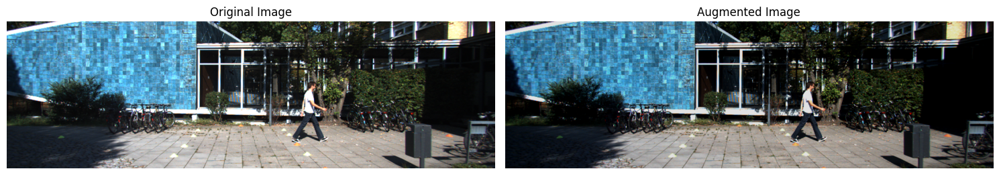

Augmenting train dataset:   0%|          | 1/5236 [00:00<35:35,  2.45it/s]

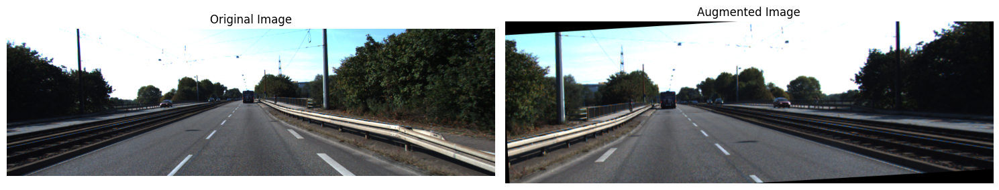

Augmenting train dataset:   0%|          | 2/5236 [00:00<34:34,  2.52it/s]

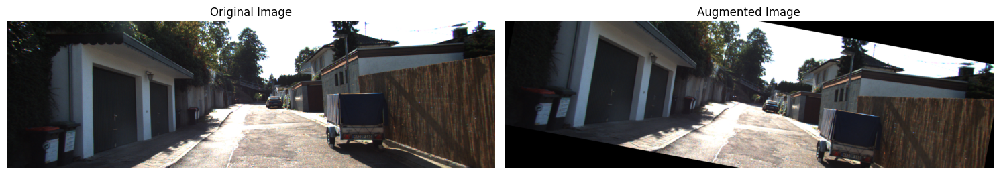

Augmenting train dataset:   0%|          | 3/5236 [00:01<35:13,  2.48it/s]

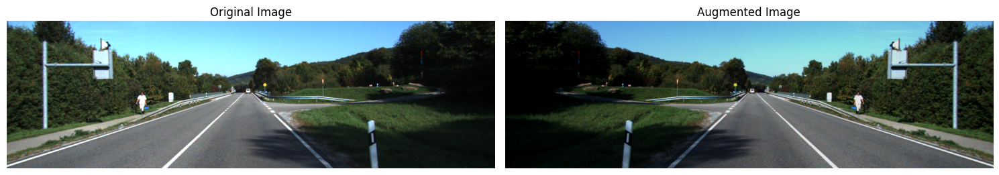

Augmenting train dataset:   0%|          | 4/5236 [00:01<36:14,  2.41it/s]

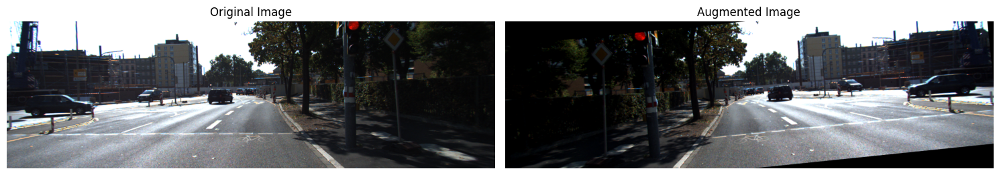

Augmenting val dataset: 100%|██████████| 748/748 [00:28<00:00, 26.58it/s]

Data augmentation completed!


In [13]:
import cv2
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2
import os
from pathlib import Path
import matplotlib.pyplot as plt
from tqdm import tqdm

# Paths to KITTI dataset and splits
KITTI_ROOT = "/kaggle/working/kitti_yolo_split"
TRAIN_IMAGE_DIR = os.path.join(KITTI_ROOT, "images/train")
TRAIN_LABEL_DIR = os.path.join(KITTI_ROOT, "labels/train")
VAL_IMAGE_DIR = os.path.join(KITTI_ROOT, "images/val")
VAL_LABEL_DIR = os.path.join(KITTI_ROOT, "labels/val")
OUTPUT_DIR = "/kaggle/working/augmented_kitti"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Define augmentation pipeline for training
train_transform = A.Compose(
    [
        A.RandomCrop(height=300, width=900, p=0.5),  # Simulate partial view
        A.HorizontalFlip(p=0.5),                     # Mimic mirrored driving
        A.Rotate(limit=15, p=0.5),                   # Simulate camera tilt
        A.RandomBrightnessContrast(p=0.3),           # Optional: lighting variation
        ToTensorV2(),                                # Convert to PyTorch tensor
    ],
    bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels'])
)

# Minimal augmentation for validation
val_transform = A.Compose(
    [
        ToTensorV2(),
    ],
    bbox_params=A.BboxParams(format='yolo', label_fields=['class_labels'])
)

# Load KITTI labels and convert to YOLO format
def load_kitti_labels(label_path):
    bboxes = []
    class_labels = []
    with open(label_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
    # Skip DontCare labels
            class_name = parts[0]
            if class_name in ['Car', 'Pedestrian', 'Cyclist']:  # Relevant classes
                x1, y1, x2, y2 = map(float, parts[4:8])
                img_width, img_height = 1242, 375  # Typical KITTI size
                x_center = (x1 + x2) / 2 / img_width
                y_center = (y1 + y2) / 2 / img_height
                width = (x2 - x1) / img_width
                height = (y2 - y1) / img_height
                bboxes.append([x_center, y_center, width, height])
                class_labels.append(class_name)
    return bboxes, class_labels

# Convert YOLO format to pixel coordinates for visualization
def yolo_to_pixel(bbox, img_width, img_height):
    x_center, y_center, width, height = bbox
    x1 = int((x_center - width / 2) * img_width)
    y1 = int((y_center - height / 2) * img_height)
    x2 = int((x_center + width / 2) * img_width)
    y2 = int((y_center + height / 2) * img_height)
    return x1, y1, x2, y2

# Draw bounding boxes on image
def draw_bboxes(image, bboxes, class_labels, img_width, img_height):
    image = image.copy()
    for bbox, cls in zip(bboxes, class_labels):
        x1, y1, x2, y2 = yolo_to_pixel(bbox, img_width, img_height)
        color = {'Car': (0, 255, 0), 'Pedestrian': (255, 0, 0), 'Cyclist': (0, 0, 255)}[cls]
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(image, cls, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return image

# Save augmented images and labels
def save_augmented_data(image, bboxes, class_labels, output_image_path, output_label_path):
    image = image.numpy().transpose(1, 2, 0) if image.shape[0] in [1, 3] else image
    cv2.imwrite(output_image_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))
    with open(output_label_path, 'w') as f:
        for bbox, cls in zip(bboxes, class_labels):
            x_center, y_center, width, height = bbox
            f.write(f"{cls} {x_center} {y_center} {width} {height}\n")

# Visualize original and augmented images
def visualize_augmentation(original_image, original_bboxes, original_labels, aug_image, aug_bboxes, aug_labels, img_width=1242, img_height=375):
    original_image = original_image.copy()
    aug_image = aug_image.numpy().transpose(1, 2, 0) if aug_image.shape[0] in [1, 3] else aug_image.copy()
    
    # Draw bounding boxes
    original_with_bboxes = draw_bboxes(original_image, original_bboxes, original_labels, img_width, img_height)
    aug_with_bboxes = draw_bboxes(aug_image, aug_bboxes, aug_labels, img_width, img_height)
    
    # Plot side by side
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 2, 1)
    plt.title("Original Image")
    plt.imshow(original_with_bboxes)
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.title("Augmented Image")
    plt.imshow(aug_with_bboxes)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# Process dataset with tqdm and visualization
def augment_dataset(image_dir, label_dir, transform, split_name, visualize_n=5):
    output_image_dir = os.path.join(OUTPUT_DIR, split_name, "images")
    output_label_dir = os.path.join(OUTPUT_DIR, split_name, "labels")
    os.makedirs(output_image_dir, exist_ok=True)
    os.makedirs(output_label_dir, exist_ok=True)

    image_files = sorted(os.listdir(image_dir))
    visualized = 0

    # Add tqdm progress bar
    for idx, file_name in enumerate(tqdm(image_files, desc=f"Augmenting {split_name} dataset")):
        # Load image and labels
        image_path = os.path.join(image_dir, file_name)
        label_path = os.path.join(label_dir, file_name.replace('.png', '.txt'))
        if not os.path.exists(label_path):
            continue
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        bboxes, class_labels = load_kitti_labels(label_path)

        # Apply augmentation
        augmented = transform(image=image, bboxes=bboxes, class_labels=class_labels)
        aug_image = augmented['image']
        aug_bboxes = augmented['bboxes']
        aug_class_labels = augmented['class_labels']

        # Visualize first N images
        if visualized < visualize_n and split_name == "train":  # Only visualize training set
            visualize_augmentation(image, bboxes, class_labels, aug_image, aug_bboxes, aug_class_labels)
            visualized += 1

        # Save augmented data
        output_image_path = os.path.join(output_image_dir, f"{idx:06d}.png")
        output_label_path = os.path.join(output_label_dir, f"{idx:06d}.txt")
        save_augmented_data(aug_image, aug_bboxes, aug_class_labels, output_image_path, output_label_path)

# Augment training and validation sets
augment_dataset(TRAIN_IMAGE_DIR, TRAIN_LABEL_DIR, train_transform, "train", visualize_n=5)
augment_dataset(VAL_IMAGE_DIR, VAL_LABEL_DIR, val_transform, "val", visualize_n=0)

print("Data augmentation completed!")

In [9]:
import shutil
import os

# Define the directory to delete
directory_to_delete = "/kaggle/working/combined_kitti"

# Check current contents of /kaggle/working
print("Current contents of /kaggle/working:")
os.system("ls /kaggle/working")

# Check if the directory exists and delete it
if os.path.exists(directory_to_delete):
    print(f"Deleting directory: {directory_to_delete}")
    shutil.rmtree(directory_to_delete)
    print(f"Directory {directory_to_delete} deleted successfully")
else:
    print(f"Directory {directory_to_delete} does not exist")

# Verify deletion
print("\nCurrent contents of /kaggle/working after deletion:")
os.system("ls /kaggle/working")

Current contents of /kaggle/working:
augmented_kitti
combined_kitti
kitti_yolo_split
runs
runs_n
yolo11n.pt
Deleting directory: /kaggle/working/combined_kitti
Directory /kaggle/working/combined_kitti deleted successfully

Current contents of /kaggle/working after deletion:
augmented_kitti
kitti_yolo_split
runs
runs_n
yolo11n.pt


0

In [ ]:
import os
import cv2
import numpy as np
from ultralytics import YOLO
from sklearn.metrics import precision_recall_fscore_support
from tqdm import tqdm
import yaml
import pandas as pd
import matplotlib.pyplot as plt
import shutil

# Define paths based on updated structure
KAGGLE_WORKING_PATH = "/kaggle/working"
PURE_DATA_PATH = "/kaggle/working/kitti_yolo_split"
AUG_DATA_PATH = "/kaggle/working/augmented_kitti"
KITTI_LABELS_PATH = "/kaggle/input/kitti-dataset/data_object_label_2/training/label_2"
# Pure training set
PURE_TRAIN_IMAGES_PATH = os.path.join(PURE_DATA_PATH, "images/train")
PURE_TRAIN_LABELS_PATH = os.path.join(PURE_DATA_PATH, "labels/train")
# Augmented training set
AUG_TRAIN_IMAGES_PATH = os.path.join(AUG_DATA_PATH, "train/images")
AUG_TRAIN_LABELS_PATH = os.path.join(AUG_DATA_PATH, "train/labels")
# Validation set
VAL_IMAGES_PATH = os.path.join(AUG_DATA_PATH, "val/images")
VAL_LABELS_PATH = os.path.join(AUG_DATA_PATH, "val/labels")
# Combined dataset
COMBINED_DATA_PATH = os.path.join(KAGGLE_WORKING_PATH, "combined_kitti")
COMBINED_TRAIN_IMAGES_PATH = os.path.join(COMBINED_DATA_PATH, "train/images")
COMBINED_TRAIN_LABELS_PATH = os.path.join(COMBINED_DATA_PATH, "train/labels")
# Output paths
MODEL_PATH = "/kaggle/working/yolo11n.pt"
TRAIN_OUTPUT_DIR = os.path.join(KAGGLE_WORKING_PATH, "runs/train_combined")
TRAINED_MODEL_PATH = os.path.join(TRAIN_OUTPUT_DIR, "weights/best.pt")
PLOTS_DIR = os.path.join(KAGGLE_WORKING_PATH, "runs/plots")

# Create directories
os.makedirs(COMBINED_TRAIN_IMAGES_PATH, exist_ok=True)
os.makedirs(COMBINED_TRAIN_LABELS_PATH, exist_ok=True)
os.makedirs(os.path.join(KAGGLE_WORKING_PATH, "runs/val"), exist_ok=True)
os.makedirs(PLOTS_DIR, exist_ok=True)

def clear_train_directory(train_dir):
    """Clear existing training directory."""
    if os.path.exists(train_dir):
        print(f"Clearing existing training directory: {train_dir}")
        shutil.rmtree(train_dir)
    os.makedirs(train_dir, exist_ok=True)

def clear_cache_files(data_path):
    """Clear cache files to force rescan of labels."""
    cache_files = [
        os.path.join(data_path, "train/labels.cache"),
        os.path.join(data_path, "val/labels.cache")
    ]
    for cache_file in cache_files:
        if os.path.exists(cache_file):
            print(f"Removing cache file: {cache_file}")
            os.remove(cache_file)

def convert_kitti_to_yolo(kitti_label_path, yolo_label_path, img_width=1242, img_height=375):
    """Convert KITTI labels to YOLO format."""
    if not os.path.exists(kitti_label_path):
        print(f"Input label file not found: {kitti_label_path}")
        with open(yolo_label_path, 'w') as f:
            f.write('')
        return 0
    try:
        with open(kitti_label_path, 'r') as f:
            lines = f.readlines()
    except Exception as e:
        print(f"Error reading {kitti_label_path}: {e}")
        with open(yolo_label_path, 'w') as f:
            f.write('')
        return 0
    
    class_mapping = {
        'car': 0,
        'van': 1,
        'truck': 2,
        'pedestrian': 3,
        'person_sitting': 4,
        'cyclist': 5,
        'tram': 6,
        'misc': 7
    }
    
    yolo_labels = []
    for line in lines:
        parts = line.strip().split()
        if len(parts) < 8:
            print(f"Skipping invalid line in {kitti_label_path}: {line.strip()}")
            continue
        class_name = parts[0].lower()
        if class_name not in class_mapping:
            continue  # Skip 'DontCare' or unknown classes
        class_id = class_mapping[class_name]
        try:
            x_min, y_min, x_max, y_max = map(float, parts[4:8])
            width = x_max - x_min
            height = y_max - y_min
            if width <= 0 or height <= 0:
                print(f"Invalid bbox in {kitti_label_path}: width={width}, height={height}")
                continue
            x_center = x_min + width / 2
            y_center = y_min + height / 2
            x_center /= img_width
            y_center /= img_height
            width /= img_width
            height /= img_height
            yolo_labels.append(f"{class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}")
        except ValueError as e:
            print(f"Error parsing line in {kitti_label_path}: {line.strip()} - {e}")
            continue
    
    with open(yolo_label_path, 'w') as f:
        f.write('\n'.join(yolo_labels))
    print(f"Generated {len(yolo_labels)} labels for {kitti_label_path}")
    return len(yolo_labels)

def merge_datasets():
    """Merge pure and augmented training datasets, skipping empty labels."""
    print("Merging pure and augmented training datasets...")
    
    # Clear combined directory
    for dir_path in [COMBINED_TRAIN_IMAGES_PATH, COMBINED_TRAIN_LABELS_PATH]:
        if os.path.exists(dir_path):
            shutil.rmtree(dir_path)
        os.makedirs(dir_path, exist_ok=True)
    
    class_mapping = {
        'car': 0,
        'van': 1,
        'truck': 2,
        'pedestrian': 3,
        'person_sitting': 4,
        'cyclist': 5,
        'tram': 6,
        'misc': 7
    }
    
    # Copy and convert pure dataset with prefix
    pure_image_files = sorted([f for f in os.listdir(PURE_TRAIN_IMAGES_PATH) if f.endswith('.png')])
    valid_pure_count = 0
    for img_file in tqdm(pure_image_files, desc="Copying and converting pure training images"):
        img_src = os.path.join(PURE_TRAIN_IMAGES_PATH, img_file)
        label_file = img_file.replace('.png', '.txt')
        kitti_label_src = os.path.join(KITTI_LABELS_PATH, label_file)
        img_dst = os.path.join(COMBINED_TRAIN_IMAGES_PATH, f"pure_{img_file}")
        label_dst = os.path.join(COMBINED_TRAIN_LABELS_PATH, f"pure_{img_file.replace('.png', '.txt')}")
        if os.path.exists(kitti_label_src):
            label_count = convert_kitti_to_yolo(kitti_label_src, label_dst)
            if label_count > 0:
                shutil.copy(img_src, img_dst)
                valid_pure_count += 1
            else:
                print(f"Skipping {img_file} due to empty labels")
        else:
            print(f"No KITTI label for {img_file}, skipping")
    
    # Copy and correct augmented dataset with prefix
    aug_image_files = sorted([f for f in os.listdir(AUG_TRAIN_IMAGES_PATH) if f.endswith('.png')])
    valid_aug_count = 0
    for img_file in tqdm(aug_image_files, desc="Copying and correcting augmented training images"):
        img_src = os.path.join(AUG_TRAIN_IMAGES_PATH, img_file)
        label_src = os.path.join(AUG_TRAIN_LABELS_PATH, img_file.replace('.png', '.txt'))
        img_dst = os.path.join(COMBINED_TRAIN_IMAGES_PATH, f"aug_{img_file}")
        label_dst = os.path.join(COMBINED_TRAIN_LABELS_PATH, f"aug_{img_file.replace('.png', '.txt')}")
        if os.path.exists(label_src):
            with open(label_src, 'r') as f:
                lines = f.readlines()
            corrected_lines = []
            for line in lines:
                parts = line.strip().split()
                if len(parts) >= 1 and parts[0].lower() in class_mapping:
                    corrected_line = f"{class_mapping[parts[0].lower()]} {' '.join(parts[1:])}"
                    corrected_lines.append(corrected_line)
                else:
                    print(f"Warning: Invalid label format in {label_src}, skipping line: {line}")
            if corrected_lines:
                shutil.copy(img_src, img_dst)
                with open(label_dst, 'w') as f:
                    f.write('\n'.join(corrected_lines))
                valid_aug_count += 1
            else:
                print(f"Skipping {img_file} due to empty labels")
        else:
            print(f"No label file for augmented image {img_file}, skipping")
    
    print(f"Combined dataset created with {valid_pure_count + valid_aug_count} images ({valid_pure_count} pure, {valid_aug_count} augmented)")

def convert_validation_labels():
    """Convert validation labels from KITTI to YOLO format."""
    print("Converting validation labels to YOLO format...")
    os.makedirs(VAL_LABELS_PATH, exist_ok=True)
    val_image_files = sorted([f for f in os.listdir(VAL_IMAGES_PATH) if f.endswith('.png')])
    valid_val_count = 0
    for img_file in tqdm(val_image_files, desc="Processing validation labels"):
        label_file = img_file.replace('.png', '.txt')
        kitti_label_src = os.path.join(KITTI_LABELS_PATH, label_file)
        yolo_label_dst = os.path.join(VAL_LABELS_PATH, label_file)
        if os.path.exists(kitti_label_src):
            label_count = convert_kitti_to_yolo(kitti_label_src, yolo_label_dst)
            if label_count > 0:
                valid_val_count += 1
        else:
            print(f"No KITTI label for validation image {img_file}, creating empty label")
            with open(yolo_label_dst, 'w') as f:
                f.write('')
    print(f"Validation set has {valid_val_count} images with valid labels")

def validate_labels(label_path, split_name):
    """Validate labels in a split."""
    label_files = sorted([f for f in os.listdir(label_path) if f.endswith('.txt')])
    empty_files = 0
    total_labels = 0
    for label_file in label_files:
        with open(os.path.join(label_path, label_file), 'r') as f:
            lines = f.readlines()
        if not lines or all(line.strip() == '' for line in lines):
            empty_files += 1
        total_labels += len(lines)
    print(f"{split_name} labels: {len(label_files)} files, {empty_files} empty, {total_labels} total annotations")
    return empty_files, total_labels

def create_kitti_yaml():
    """Create kitti.yaml for combined dataset."""
    kitti_yaml = {
        "path": COMBINED_DATA_PATH,
        "train": "train/images",
        "val": VAL_IMAGES_PATH,
        "names": {
            0: "car",
            1: "van",
            2: "truck",
            3: "pedestrian",
            4: "person_sitting",
            5: "cyclist",
            6: "tram",
            7: "misc"
        }
    }
    yaml_path = os.path.join(KAGGLE_WORKING_PATH, "runs/kitti_combined.yaml")
    with open(yaml_path, "w") as f:
        yaml.dump(kitti_yaml, f)
    return yaml_path

def load_kitti_labels(label_path):
    """Load YOLO-format labels."""
    labels = []
    if os.path.exists(label_path):
        with open(label_path, "r") as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue
                try:
                    class_id, x_center, y_center, width, height = map(float, parts)
                    if class_id in [0, 1, 2, 3, 4, 5, 6, 7]:
                        labels.append([int(class_id), x_center, y_center, width, height])
                except ValueError:
                    continue
    return np.array(labels)

def calculate_iou(box1, box2):
    """Calculate IoU between two bounding boxes."""
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    x1_min, y1_min = x1 - w1 / 2, y1 - h1 / 2
    x1_max, y1_max = x1 + w1 / 2, y1 + h1 / 2
    x2_min, y2_min = x2 - w2 / 2, y2 - h2 / 2
    x2_max, y2_max = x2 + w2 / 2, y2 + h2 / 2
    inter_x_min = max(x1_min, x2_min)
    inter_y_min = max(y1_min, y2_min)
    inter_x_max = min(x1_max, x2_max)
    inter_y_max = min(y1_max, y2_max)
    inter_area = max(0, inter_x_max - inter_x_min) * max(0, inter_y_max - inter_y_min)
    union_area = (w1 * h1) + (w2 * h2) - inter_area
    return inter_area / union_area if union_area > 0 else 0

def evaluate_predictions(predictions, ground_truths, iou_threshold=0.5):
    """Evaluate predictions per class."""
    class_metrics = {
        0: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        1: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        2: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        3: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        4: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        5: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        6: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0},
        7: {'tp': 0, 'fp': 0, 'fn': 0, 'preds': [], 'gts': [], 'pred_count': 0, 'gt_count': 0}
    }
    for pred, gt in zip(predictions, ground_truths):
        pred_boxes = pred['boxes'] if pred else []
        gt_boxes = gt
        for class_id in class_metrics:
            pred_cls = [p for p in pred_boxes if p[0] == class_id]
            gt_cls = [g for g in gt_boxes if g[0] == class_id]
            class_metrics[class_id]['pred_count'] += len(pred_cls)
            class_metrics[class_id]['gt_count'] += len(gt_cls)
            matched = set()
            for i, pb in enumerate(pred_cls):
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_cls):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_threshold and max_idx not in matched:
                    class_metrics[class_id]['tp'] += 1
                    matched.add(max_idx)
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(class_id)
                else:
                    class_metrics[class_id]['fp'] += 1
                    class_metrics[class_id]['preds'].append(class_id)
                    class_metrics[class_id]['gts'].append(-1)
            class_metrics[class_id]['fn'] += len(gt_cls) - len(matched)
            for j, gb in enumerate(gt_cls):
                if j not in matched:
                    class_metrics[class_id]['gts'].append(class_id)
                    class_metrics[class_id]['preds'].append(-1)
    metrics = {}
    for class_id, data in class_metrics.items():
        precision, recall, f1, _ = precision_recall_fscore_support(
            data['gts'], data['preds'], average='macro', zero_division=0
        )
        metrics[class_id] = {
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'mAP': calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold),
            'pred_count': data['pred_count'],
            'gt_count': data['gt_count']
        }
    all_precisions = [m['precision'] for m in metrics.values()]
    all_recalls = [m['recall'] for m in metrics.values()]
    all_f1s = [m['f1'] for m in metrics.values()]
    all_maps = [m['mAP'] for m in metrics.values()]
    overall = {
        'precision': np.mean(all_precisions),
        'recall': np.mean(all_recalls),
        'f1': np.mean(all_f1s),
        'mAP': np.mean(all_maps)
    }
    return metrics, overall

def calculate_map_per_class(predictions, ground_truths, class_id, iou_threshold=0.5):
    """Calculate mAP for a specific class."""
    precisions, recalls = [], []
    for iou_th in np.arange(0.5, 1.0, 0.05):
        tp, fp, fn = 0, 0, 0
        for pred, gt in zip(predictions, ground_truths):
            pred_boxes = [p for p in (pred['boxes'] if pred else []) if p[0] == class_id]
            gt_boxes = [g for g in gt if g[0] == class_id]
            matched = set()
            for pb in pred_boxes:
                max_iou = 0
                max_idx = -1
                for j, gb in enumerate(gt_boxes):
                    if j not in matched:
                        iou = calculate_iou(pb[1:], gb[1:])
                        if iou > max_iou:
                            max_iou = iou
                            max_idx = j
                if max_iou >= iou_th and max_idx not in matched:
                    tp += 1
                    matched.add(max_idx)
                else:
                    fp += 1
            fn += len(gt_boxes) - len(matched)
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0
        precisions.append(precision)
        recalls.append(recall)
    if precisions and recalls:
        precisions = np.array(precisions)
        recalls = np.array(recalls)
        sorted_idx = np.argsort(recalls)
        precisions = precisions[sorted_idx]
        recalls = recalls[sorted_idx]
        for i in range(len(precisions) - 2, -1, -1):
            precisions[i] = max(precisions[i], precisions[i + 1])
        ap = np.trapz(precisions, recalls) if recalls.size > 1 else 0
        ap = max(0, ap)
    else:
        ap = 0
    return ap

def plot_training_curves(results_csv, output_dir):
    """Plot training and validation curves."""
    df = pd.read_csv(results_csv)
    columns = [
        'epoch',
        'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
        'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)',
        'val/box_loss', 'val/cls_loss', 'val/dfl_loss'
    ]
    if not all(col in df.columns for col in columns):
        print(f"Warning: results.csv missing expected columns. Found: {df.columns}")
        return
    epochs = df['epoch'].values + 1
    plt.figure(figsize=(12, 6))
    plt.plot(epochs, df['train/box_loss'], label='Train Box Loss', color='blue')
    plt.plot(epochs, df['val/box_loss'], label='Val Box Loss', color='cyan')
    plt.plot(epochs, df['train/cls_loss'], label='Train Cls Loss', color='red')
    plt.plot(epochs, df['val/cls_loss'], label='Val Cls Loss', color='pink')
    plt.plot(epochs, df['train/dfl_loss'], label='Train DFL Loss', color='green')
    plt.plot(epochs, df['val/dfl_loss'], label='Val DFL Loss', color='lime')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training and Validation Losses')
    plt.legend()
    plt.grid(True)
    plt.savefig(os.path.join(output_dir, 'losses.png'))
    plt.close()
    plt.figure(figsize=(12, 6))
    plt.plot(epochs, df['metrics/precision(B)'], label='Precision', color='blue')
    plt.plot(epochs, df['metrics/recall(B)'], label='Recall', color='red')
    plt.plot(epochs, df['metrics/mAP50(B)'], label='mAP@0.5', color='green')
    plt.plot(epochs, df['metrics/mAP50-95(B)'], label='mAP@0.5:0.95', color='purple')
    plt.xlabel('Epoch')
    plt.ylabel('Metric Value')
    plt.title('Validation Metrics')
    plt.legend()
    plt.grid(True)
    plt.savefig(os.path.join(output_dir, 'metrics.png'))
    plt.close()
    print(f"Training curves saved to {output_dir}")

def main():
    """Main function to merge pure and augmented KITTI datasets, train YOLO model, and evaluate."""
    # Merge pure and augmented training datasets
    merge_datasets()

    # Convert validation labels
    convert_validation_labels()

    # Verify combined dataset
    train_files = sorted([f for f in os.listdir(COMBINED_TRAIN_IMAGES_PATH) if f.endswith('.png')])
    val_files = sorted([f for f in os.listdir(VAL_IMAGES_PATH) if f.endswith('.png')])
    print(f"Combined Train: {len(train_files)} images, Val: {len(val_files)} images")

    # Clear previous training directory and cache
    clear_train_directory(TRAIN_OUTPUT_DIR)
    clear_cache_files(COMBINED_DATA_PATH)

    # Validate labels
    print("Validating labels...")
    train_empty, train_total = validate_labels(COMBINED_TRAIN_LABELS_PATH, "Combined Train")
    val_empty, val_total = validate_labels(VAL_LABELS_PATH, "Val")
    if train_empty == len(train_files):
        print("Error: All training label files are empty. Aborting.")
        return
    if val_empty == len(val_files):
        print("Warning: All validation label files are empty. Evaluation may be incomplete.")

    # Create kitti.yaml
    print("Creating kitti.yaml...")
    yaml_path = create_kitti_yaml()
    print(f"kitti.yaml created at {yaml_path}")

    # Load model
    model = YOLO(MODEL_PATH)
    print(f"Loaded YOLOv11 model: {MODEL_PATH}")

    # Start training
    print("Starting training on combined KITTI dataset...")
    model.train(
        data=yaml_path,
        epochs=50,
        imgsz=640,
        batch=32,
        device=0,
        project=os.path.join(KAGGLE_WORKING_PATH, "runs"),
        name="train_combined",
        patience=20,
        lr0=0.01,
        optimizer="AdamW",
        cos_lr=True,
        freeze=5,
        hsv_h=0.015,
        hsv_s=0.7,
        hsv_v=0.4,
        degrees=5.0,
        translate=0.1,
        scale=0.2,
        mosaic=1.0,
        save_period=10,
        exist_ok=True
    )
    print("Training completed.")

    # Plot training curves
    results_csv = os.path.join(TRAIN_OUTPUT_DIR, "results.csv")
    if os.path.exists(results_csv):
        plot_training_curves(results_csv, PLOTS_DIR)
    else:
        print(f"Error: results.csv not found at {results_csv}")

    # Load trained model for validation
    trained_model = YOLO(TRAINED_MODEL_PATH)
    print(f"Loaded trained model: {TRAINED_MODEL_PATH}")

    # Run inference on validation set
    image_files = sorted([f for f in os.listdir(VAL_IMAGES_PATH) if f.endswith('.png')])
    predictions = []
    ground_truths = []
    for img_file in tqdm(image_files, desc="Running inference on validation set"):
        img_path = os.path.join(VAL_IMAGES_PATH, img_file)
        label_path = os.path.join(VAL_LABELS_PATH, img_file.replace('.png', '.txt'))
        img = cv2.imread(img_path)
        if img is None:
            print(f"Failed to load image: {img_path}")
            continue
        results = trained_model.predict(img_path, conf=0.5, iou=0.7, verbose=False)
        pred_boxes = []
        for result in results:
            boxes = result.boxes
            for box, cls, conf in zip(boxes.xywhn, boxes.cls, boxes.conf):
                class_id = int(cls)
                if class_id in [0, 1, 2, 3, 4, 5, 6, 7]:
                    pred_boxes.append([class_id, float(box[0]), float(box[1]), float(box[2]), float(box[3])])
        predictions.append({'boxes': pred_boxes})
        gt_boxes = load_kitti_labels(label_path)
        ground_truths.append(gt_boxes)
        result_img = results[0].plot()
        cv2.imwrite(os.path.join(KAGGLE_WORKING_PATH, "runs/val", img_file), result_img)

    # Evaluate performance
    class_metrics, overall_metrics = evaluate_predictions(predictions, ground_truths, iou_threshold=0.5)
    class_names = {
        0: 'Car',
        1: 'Van',
        2: 'Truck',
        3: 'Pedestrian',
        4: 'Person_sitting',
        5: 'Cyclist',
        6: 'Tram',
        7: 'Misc'
    }
    print("\nPerformance Metrics on KITTI Validation Set (Combined Model):")
    for class_id, metrics in class_metrics.items():
        print(f"Class: {class_names[class_id]}")
        print(f"  Precision: {metrics['precision']:.4f}")
        print(f"  Recall: {metrics['recall']:.4f}")
        print(f"  F1 Score: {metrics['f1']:.4f}")
        print(f"  mAP@0.5: {metrics['mAP']:.4f}")
        print(f"  Predicted Instances: {metrics['pred_count']}")
        print(f"  Ground Truth Instances: {metrics['gt_count']}")
    print("Overall (Macro-Average):")
    print(f"  Precision: {overall_metrics['precision']:.4f}")
    print(f"  Recall: {overall_metrics['recall']:.4f}")
    print(f"  F1 Score: {overall_metrics['f1']:.4f}")
    print(f"  mAP@0.5: {overall_metrics['mAP']:.4f}")

if __name__ == "__main__":
    main()

Merging pure and augmented training datasets...


Copying and correcting augmented training images: 100%|██████████| 5236/5236 [00:04<00:00, 1247.22it/s]


Combined dataset created with 10472 images
Converting validation labels to YOLO format...


Processing validation labels: 100%|██████████| 748/748 [00:02<00:00, 338.69it/s]


Combined Train: 10472 images, Val: 748 images
Clearing existing training directory: /kaggle/working/runs/train_combined
Removing cache file: /kaggle/working/combined_kitti/train/labels.cache
Validating labels...
Combined Train labels: 10472 files, 5236 empty, 28396 total annotations
Val labels: 748 files, 0 empty, 3962 total annotations
Creating kitti.yaml...
kitti.yaml created at /kaggle/working/runs/kitti_combined.yaml
Loaded YOLOv11 model: /kaggle/working/yolo11n.pt
Starting training on combined KITTI dataset...
Ultralytics 8.3.137 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=/kaggle/working/runs/kitti_combined.yaml, degrees=15.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed

train: Scanning /kaggle/working/combined_kitti/train/labels... 10472 images, 5236 backgrounds, 0 corrupt: 100%|██████████| 10472/10472 [00:47<00:00, 221.24it/s]


train: New cache created: /kaggle/working/combined_kitti/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2144.4±1991.7 MB/s, size: 809.6 KB)


val: Scanning /kaggle/working/augmented_kitti/val/labels.cache... 748 images, 0 backgrounds, 0 corrupt: 100%|██████████| 748/748 [00:00<?, ?it/s]


Plotting labels to /kaggle/working/runs/train_combined/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /kaggle/working/runs/train_combined
Starting training for 75 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/75      2.68G       1.62      2.048      1.249         63        640: 100%|██████████| 328/328 [02:19<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.60it/s]

                   all        748       3962      0.132     0.0115    0.00155   0.000393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/75      2.69G       1.48      1.649      1.201         26        640: 100%|██████████| 328/328 [02:14<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:05<00:00,  2.39it/s]

                   all        748       3962      0.133    0.00867    0.00171   0.000499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/75      2.69G      1.426      1.544      1.175         55        640: 100%|██████████| 328/328 [02:14<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.43it/s]

                   all        748       3962     0.0103    0.00707    0.00179   0.000466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/75      2.69G      1.396      1.483      1.162         49        640: 100%|██████████| 328/328 [02:13<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.57it/s]

                   all        748       3962    0.00717    0.00989     0.0015   0.000445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/75      2.69G       1.37      1.428      1.146         33        640: 100%|██████████| 328/328 [02:14<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.55it/s]

                   all        748       3962    0.00777    0.00837    0.00167   0.000528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/75      2.69G      1.334      1.387       1.13         17        640: 100%|██████████| 328/328 [02:13<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.48it/s]

                   all        748       3962     0.0102    0.00802    0.00153   0.000408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/75      2.69G       1.32      1.363      1.123         11        640: 100%|██████████| 328/328 [02:12<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.52it/s]

                   all        748       3962    0.00959    0.00911    0.00169   0.000507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/75      2.69G      1.304      1.323      1.114         57        640: 100%|██████████| 328/328 [02:13<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:05<00:00,  2.34it/s]

                   all        748       3962     0.0081     0.0103    0.00171   0.000514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/75      2.69G      1.268      1.285        1.1         35        640: 100%|██████████| 328/328 [02:12<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.52it/s]

                   all        748       3962    0.00826    0.00978    0.00149   0.000418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/75      2.69G       1.26       1.28      1.094         30        640: 100%|██████████| 328/328 [02:13<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.51it/s]

                   all        748       3962    0.00885    0.00905    0.00187   0.000631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/75      2.69G      1.258      1.267      1.093         58        640: 100%|██████████| 328/328 [02:13<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.63it/s]

                   all        748       3962      0.133    0.00919    0.00148   0.000399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/75      2.69G      1.244      1.257      1.087         40        640: 100%|██████████| 328/328 [02:13<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.47it/s]


                   all        748       3962     0.0077    0.00961    0.00203   0.000661

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/75      2.69G      1.232      1.236      1.082         60        640: 100%|██████████| 328/328 [02:12<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.41it/s]

                   all        748       3962    0.00776     0.0119    0.00172   0.000557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/75      2.69G      1.224       1.22      1.074         63        640: 100%|██████████| 328/328 [02:13<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.54it/s]

                   all        748       3962    0.00675    0.00954    0.00175   0.000568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/75      2.88G      1.214      1.206      1.073         38        640: 100%|██████████| 328/328 [02:13<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:05<00:00,  2.35it/s]

                   all        748       3962      0.012    0.00923    0.00179    0.00049



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/75      2.88G      1.209      1.192      1.068         41        640: 100%|██████████| 328/328 [02:13<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.67it/s]

                   all        748       3962    0.00836     0.0087    0.00178   0.000551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/75      2.88G        1.2      1.185      1.061         39        640: 100%|██████████| 328/328 [02:13<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.45it/s]

                   all        748       3962    0.00641     0.0106    0.00163   0.000457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/75      2.88G       1.19      1.173      1.059         32        640: 100%|██████████| 328/328 [02:13<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.46it/s]

                   all        748       3962    0.00948    0.00813    0.00179   0.000485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/75      2.88G      1.193      1.166      1.061         79        640: 100%|██████████| 328/328 [02:13<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.60it/s]

                   all        748       3962    0.00873     0.0101    0.00158   0.000426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/75      2.88G      1.174      1.144      1.051         30        640: 100%|██████████| 328/328 [02:13<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 12/12 [00:04<00:00,  2.42it/s]

                   all        748       3962    0.00755     0.0111    0.00172   0.000492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/75      2.88G      1.172      1.147       1.05        166        640:  41%|████      | 135/328 [00:54<01:12,  2.65it/s]

In [16]:
!pip install onnxruntime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.4/16.4 MB 86.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 6.0 MB/s eta 0:00:00


In [19]:
import cv2
import numpy as np
import onnxruntime as ort
import time
from tqdm import tqdm
import os

# Paths
MODEL_PATH = "/kaggle/working/kitti_yolo/train/weights/best.pt"
ONNX_MODEL_PATH = "/kaggle/working/runs/train_combined/weights/best.onnx"
INPUT_DIR = "/kaggle/working/kitti_yolo_split/images/val"  # Non-augmented validation images
OUTPUT_DIR = "/kaggle/working/runs/inference_results"

# Create output directory
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Export YOLOv11 model to ONNX (run once)
def export_to_onnx():
    from ultralytics import YOLO
    model = YOLO(MODEL_PATH)
    model.export(format="onnx", imgsz=640, optimize=True, dynamic=False, simplify=True)
    print(f"Model exported to {ONNX_MODEL_PATH}")

# Load ONNX model and optimize
def load_optimized_model():
    session_options = ort.SessionOptions()
    session_options.graph_optimization_level = ort.GraphOptimizationLevel.ORT_ENABLE_ALL
    providers = ['CUDAExecutionProvider', 'CPUExecutionProvider']
    session = ort.InferenceSession(ONNX_MODEL_PATH, sess_options=session_options, providers=providers)
    return session

# Preprocess image
def preprocess_image(image_path, img_size=640):
    img = cv2.imread(image_path)
    if img is None:
        raise ValueError(f"Failed to load image: {image_path}")
    orig_shape = img.shape[:2]  # (height, width)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (img_size, img_size))
    img = img.transpose((2, 0, 1))  # HWC to CHW
    img = np.expand_dims(img, axis=0).astype(np.float32) / 255.0  # Normalize to [0, 1]
    return img, orig_shape

# Postprocess detections
def postprocess_detections(outputs, orig_shape, conf_threshold=0.5, iou_threshold=0.7):
    if not outputs or len(outputs[0]) == 0:
        return np.array([]), np.array([]), np.array([])
    
    boxes = outputs[0][0]  # Shape: [num_boxes, 6] (x, y, w, h, conf, class_id)
    if boxes.shape[0] == 0:
        return np.array([]), np.array([]), np.array([])
    
    scores = boxes[:, 4]
    class_ids = boxes[:, 5].astype(np.int32)
    boxes = boxes[:, :4]  # x_center, y_center, width, height (normalized 0-1)
    
    # Map model class IDs to desired mapping (if model uses different mapping)
    model_to_user = {
        0: 0,  # Car -> car
        1: 1,  # Van -> van
        5: 2,  # Truck -> truck
        3: 3,  # Pedestrian -> pedestrian
        2: 4,  # Person_sitting -> person_sitting
        4: 5,  # Cyclist -> cyclist
        6: 6,  # Tram -> tram
        7: 7   # Misc -> misc
    }
    mapped_class_ids = np.array([model_to_user.get(cid, -1) for cid in class_ids])
    valid_mask = mapped_class_ids >= 0
    boxes = boxes[valid_mask]
    scores = scores[valid_mask]
    mapped_class_ids = mapped_class_ids[valid_mask]
    
    # Filter by confidence
    mask = scores >= conf_threshold
    boxes = boxes[mask]
    scores = scores[mask]
    class_ids = mapped_class_ids[mask]
    
    if len(boxes) == 0:
        return np.array([]), np.array([]), np.array([])
    
    # Convert boxes to [x1, y1, x2, y2] for NMS
    boxes_xyxy = np.zeros_like(boxes)
    boxes_xyxy[:, 0] = boxes[:, 0] - boxes[:, 2] / 2  # x1
    boxes_xyxy[:, 1] = boxes[:, 1] - boxes[:, 3] / 2  # y1
    boxes_xyxy[:, 2] = boxes[:, 0] + boxes[:, 2] / 2  # x2
    boxes_xyxy[:, 3] = boxes[:, 1] + boxes[:, 3] / 2  # x2
    
    # NMS
    indices = cv2.dnn.NMSBoxes(
        boxes_xyxy.tolist(), scores.tolist(), conf_threshold, iou_threshold
    )
    if len(indices) > 0:
        indices = indices.flatten()
        boxes = boxes[indices]
        scores = scores[indices]
        class_ids = class_ids[indices]
    else:
        boxes = np.array([])
        scores = np.array([])
        class_ids = np.array([])
    
    # Scale boxes to original image size
    orig_h, orig_w = orig_shape
    if len(boxes) > 0:
        boxes[:, 0] *= orig_w / 640  # x_center
        boxes[:, 1] *= orig_h / 640  # y_center
        boxes[:, 2] *= orig_w / 640  # width
        boxes[:, 3] *= orig_h / 640  # height
    
    return boxes, scores, class_ids

# Inference pipeline
def inference_pipeline(session, input_dir, output_dir):
    image_files = sorted([f for f in os.listdir(input_dir) if f.endswith('.png')])
    class_names = {
        0: 'car',
        1: 'van',
        2: 'truck',
        3: 'pedestrian',
        4: 'person_sitting',
        5: 'cyclist',
        6: 'tram',
        7: 'misc'
    }
    
    for img_file in tqdm(image_files, desc="Running inference"):
        image_path = os.path.join(input_dir, img_file)
        output_path = os.path.join(output_dir, img_file)
        
        # Preprocess
        try:
            input_tensor, orig_shape = preprocess_image(image_path)
        except ValueError as e:
            print(f"Error preprocessing {img_file}: {e}")
            continue
        
        # Inference
        start_time = time.time()
        outputs = session.run(None, {"images": input_tensor})
        inference_time = time.time() - start_time
        
        # Postprocess
        boxes, scores, class_ids = postprocess_detections(outputs, orig_shape, conf_threshold=0.5, iou_threshold=0.7)
        
        # Visualize results
        img = cv2.imread(image_path)
        for box, score, class_id in zip(boxes, scores, class_ids):
            x, y, w, h = box
            x1, y1 = int(x - w / 2), int(y - h / 2)
            x2, y2 = int(x + w / 2), int(y + h / 2)
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
            label = f"{class_names[class_id]}: {score:.2f}"
            cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        
        # Save result
        cv2.imwrite(output_path, img)
        print(f"Inferred {img_file} in {inference_time:.3f} seconds")

def main():
    # Export model to ONNX (run this step manually first if not already done)
    if not os.path.exists(ONNX_MODEL_PATH):
        export_to_onnx()
    else:
        print(f"ONNX model already exists at {ONNX_MODEL_PATH}")
    
    # Load optimized model
    try:
        session = load_optimized_model()
        print(f"Loaded optimized ONNX model with {session.get_inputs()[0].name} as input")
    except Exception as e:
        print(f"Error loading ONNX model: {e}")
        return
    
    # Run inference pipeline
    inference_pipeline(session, INPUT_DIR, OUTPUT_DIR)
    print(f"Inference completed. Results saved to {OUTPUT_DIR}")

if __name__ == "__main__":
    main()

Ultralytics 8.3.139 🚀 Python-3.11.11 torch-2.5.1+cu124 CPU (Intel Xeon 2.00GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel CPUs. Learn more at https://docs.ultralytics.com/integrations/openvino/
YOLO11n summary (fused): 100 layers, 2,583,712 parameters, 0 gradients, 6.3 GFLOPs

PyTorch: starting from '/kaggle/working/kitti_yolo/train/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 12, 8400) (5.2 MB)
requirements: Ultralytics requirements ['onnxslim>=0.1.53', 'onnxruntime-gpu'] not found, attempting AutoUpdate...


Using Python 3.11.11 environment at: /usr
Resolved 22 packages in 222ms



requirements: AutoUpdate success ✅ 3.3s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect



 Downloaded onnxruntime-gpu
Prepared 2 packages in 2.56s
Installed 2 packages in 135ms
 + onnxruntime-gpu==1.22.0
 + onnxslim==0.1.53



ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.53...
ONNX: export success ✅ 5.5s, saved as '/kaggle/working/kitti_yolo/train/weights/best.onnx' (10.1 MB)

Export complete (6.1s)
Results saved to /kaggle/working/kitti_yolo/train/weights
Predict:         yolo predict task=detect model=/kaggle/working/kitti_yolo/train/weights/best.onnx imgsz=640  
Validate:        yolo val task=detect model=/kaggle/working/kitti_yolo/train/weights/best.onnx imgsz=640 data=/kaggle/working/kitti_yolo/kitti.yaml  
Visualize:       https://netron.app
Model exported to /kaggle/working/runs/train_combined/weights/best.onnx
Error loading ONNX model: [ONNXRuntimeError] : 3 : NO_SUCHFILE : Load model from /kaggle/working/runs/train_combined/weights/best.onnx failed:Load model /kaggle/working/runs/train_combined/weights/best.onnx failed. File doesn't exist
